The cell below produces a button that toggles code in this notebook on and off.

In [5]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')



# A birds-eye view of Recurrent Neural Networks


## Jeremy Watt (<a href="https://www.dgsix.com/" target="_blank">dgsix</a>, <a href="https://twitter.com/neonwatty" target="_blank">@neonwatty</a>)




# Agenda

## 1.  Naturally ordered data and good storytelling

## 2.  Dynamic system models 

## 3.  Putting Humpty-Dumpty back together again

# 0.  Prologue: supervised learning 

- **supervised learning:** a jargon phrase, means the pursuit of *relationship* between input and output data

- "relationship" means a math / computational function (a "natural law") describing input/output correspondence

- determining appropriate relationship between input and output involves:
    - finding an appropriate **model**
    - appropriately **tuning parameters** of that model

- simplest case: we know what model to use, and only need tune its params

- e.g., a toy *regression* dataset, here a line is clearly the correct model

<figure>
<p>
<img src= '../images/linear_regression_data.png' width="54%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em>
</figcaption>
</figure>

- so you choose a *linear model*  

$$
\text{model}\left(x,\Theta\right) = w_0 + xw_1
$$

- you then press it onto the data correctly by tuning the *params* $\Theta = \left\{w_0,w_1\right\}$ 

In [ ]:
# simple linear model using numpy 'dot' for quick multiplication
# params packaged as theta = [w_0,w_1,...]
def model(x,theta):
    # compute linear combination of input
    a = theta[0] + np.dot(x.T,theta[1:])
    return a.T

- and that tuning process <a href="https://jermwatt.github.io/mlrefined/blog_posts/5_Linear_regression/5_1_Least.html" target="_blank">looks like this</a>...


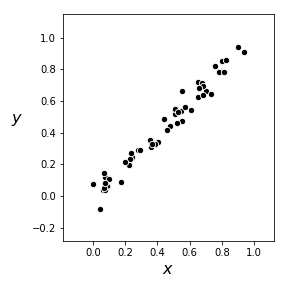
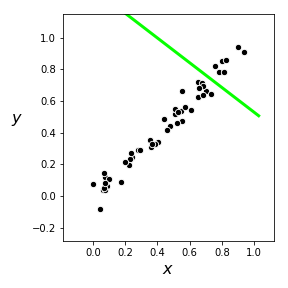
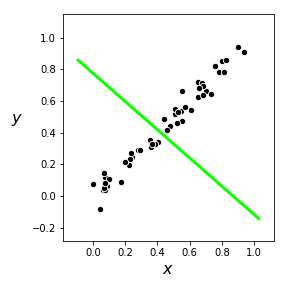
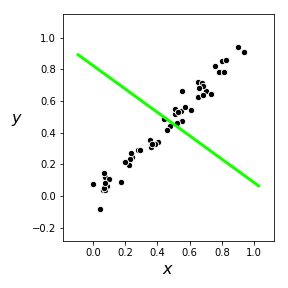
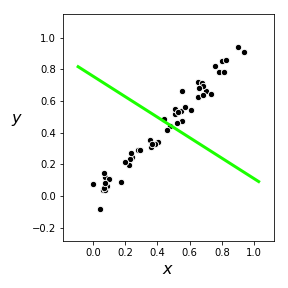
...
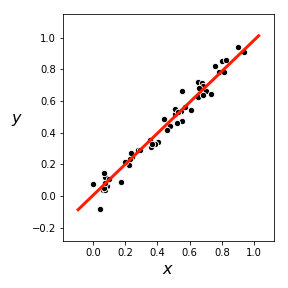
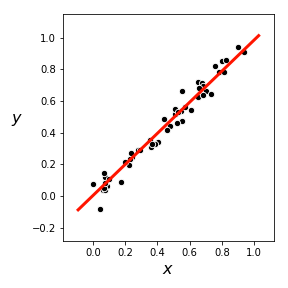
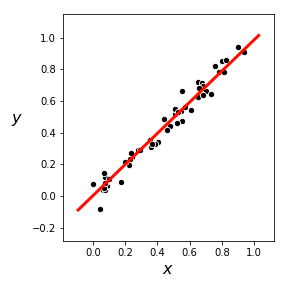
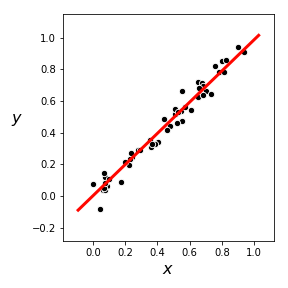
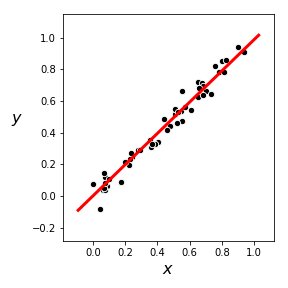

In [7]:
## This code cell will not be shown in the HTML version of this notebook
# animate descent process
demo.animate_it_2d_fit_only(weight_history)

# 1.  Naturally ordered data and good storytelling

# Naturally ordered data

- the "standard" stuff is designed to deal with data that arrives in no particular order (data that is "i.i.d."), 

- data is assumed to just sort of pops into existance at random - like this


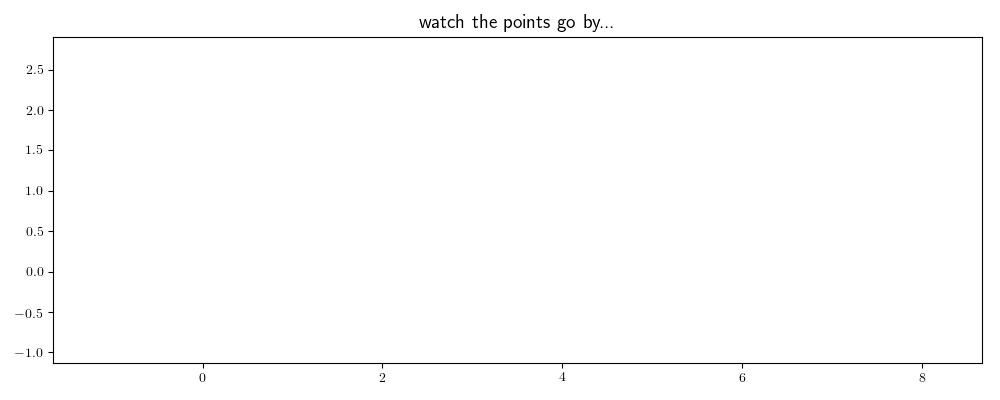
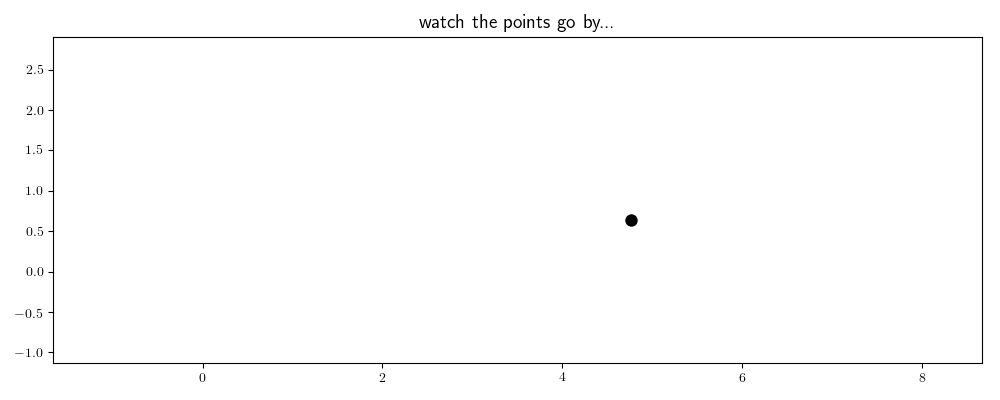
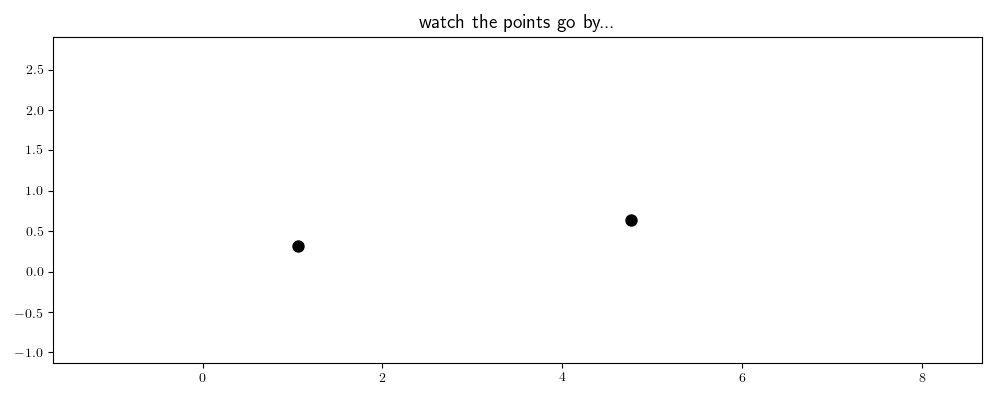
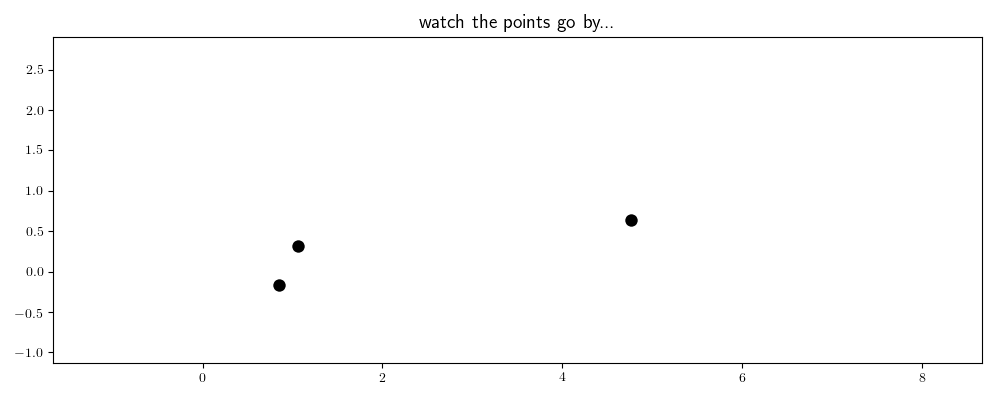
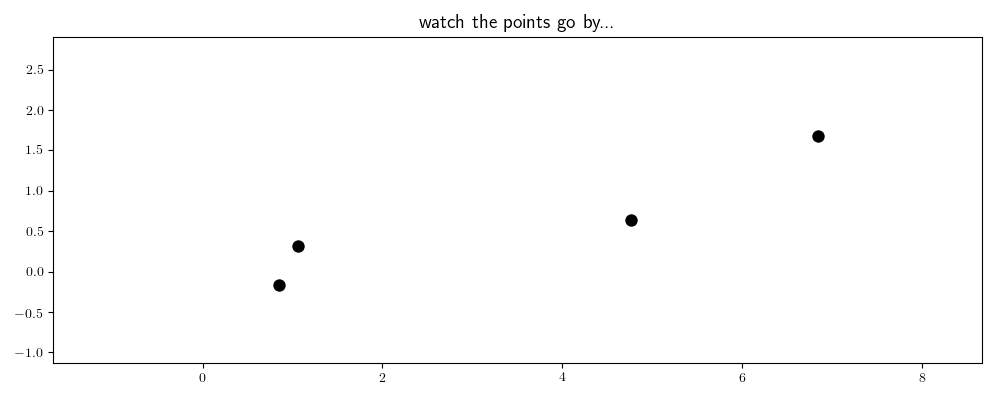
...
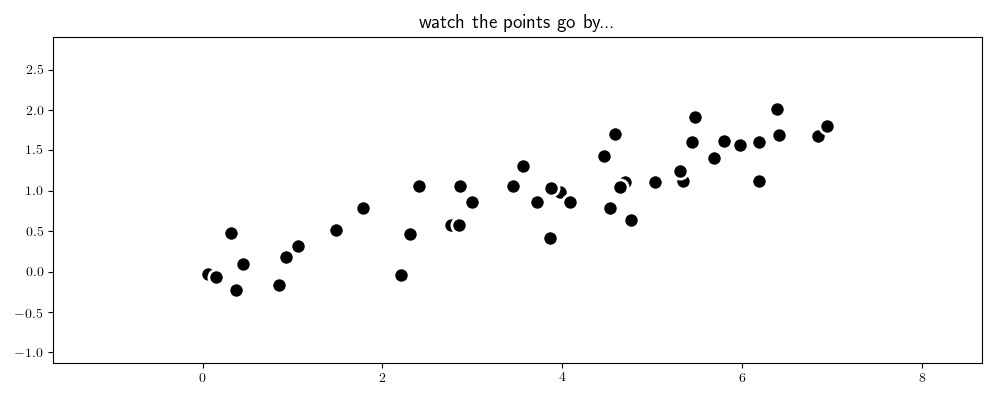
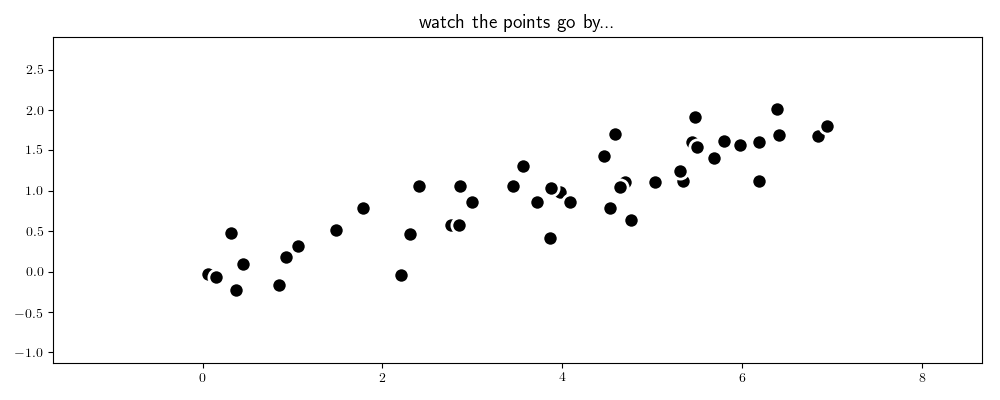
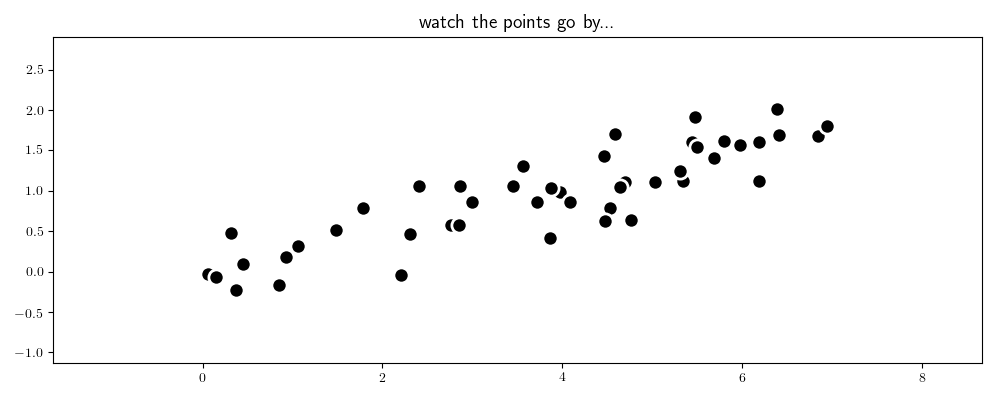
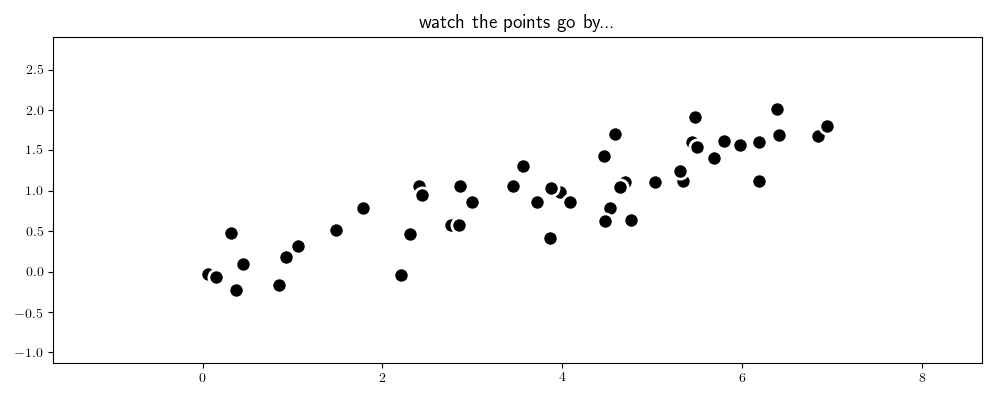
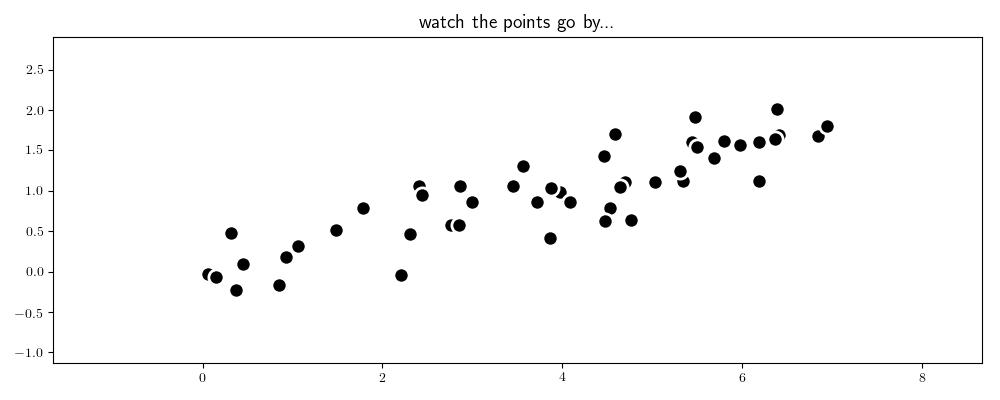

In [19]:
## This code cell will not be shown in the HTML version of this notebook
# make a toy regression dataset
num_pts = 50
x = 7*np.random.rand(num_pts,1)
y = 0.25*x
y += 0.25*np.random.randn(num_pts,1)
y.shape = (len(y),1)

# make ordered version
xc = copy.deepcopy(x)
yc = copy.deepcopy(y)
sorted_inds = np.argsort(xc,axis = 0)
xc = xc[sorted_inds]
yc = yc[sorted_inds]

# animate order
demo1 = recurlib.iid_demo.Visualizer()
demo1.single_plot(x,y)

# Naturally ordered data

- thats fine for a lot of big problems --> object detection, genetics, many metadata problems, etc., - where the "arrival order" of data isn't important

- but many kinds of data are *naturally ordered*

 - that is, the data "arrives" like this


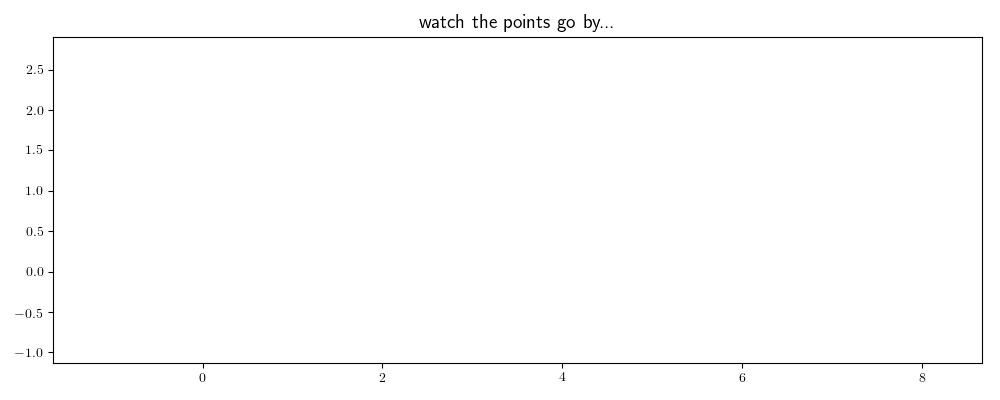
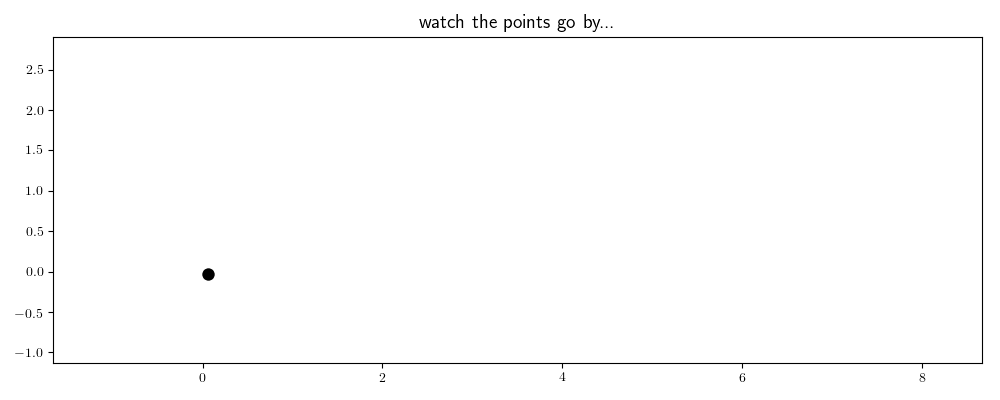
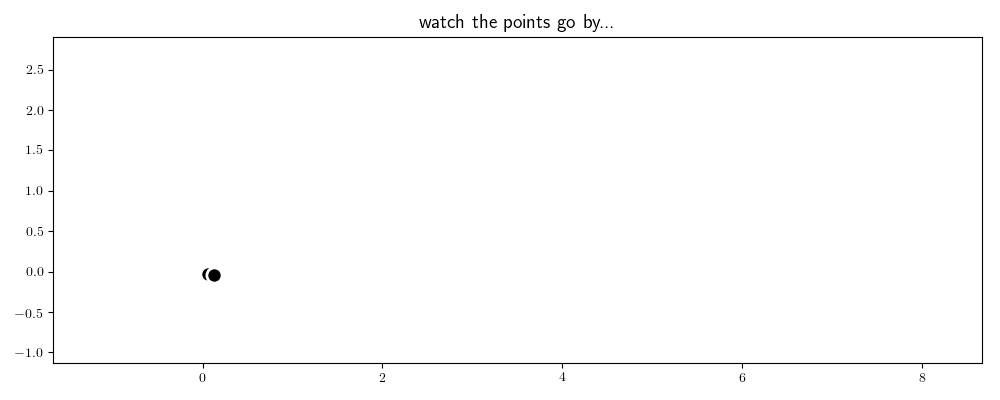
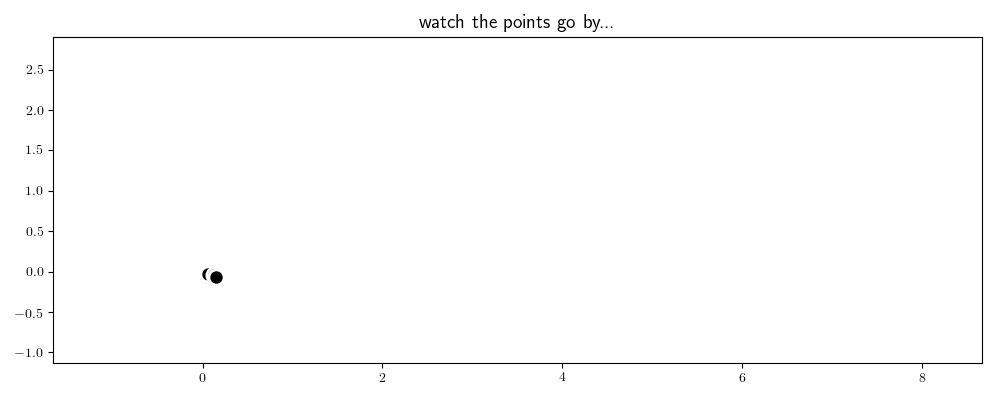
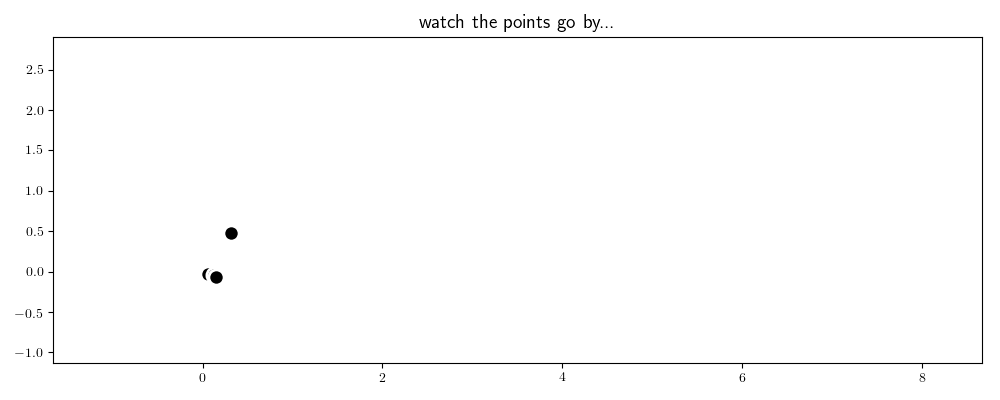
...
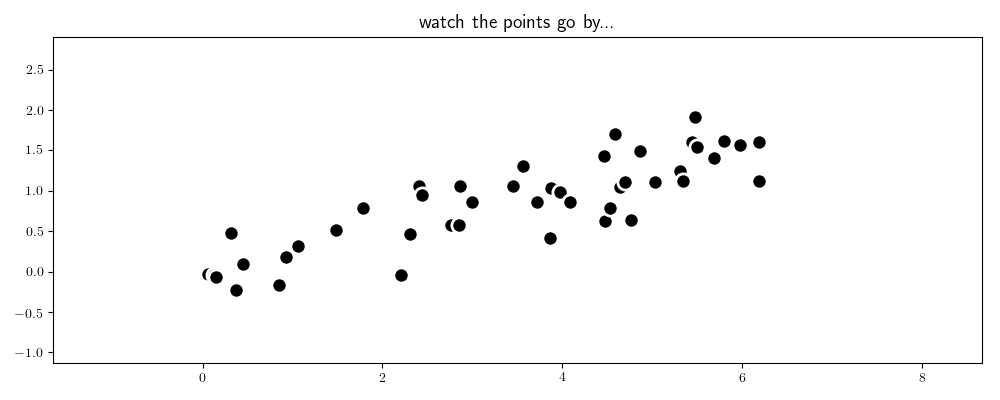
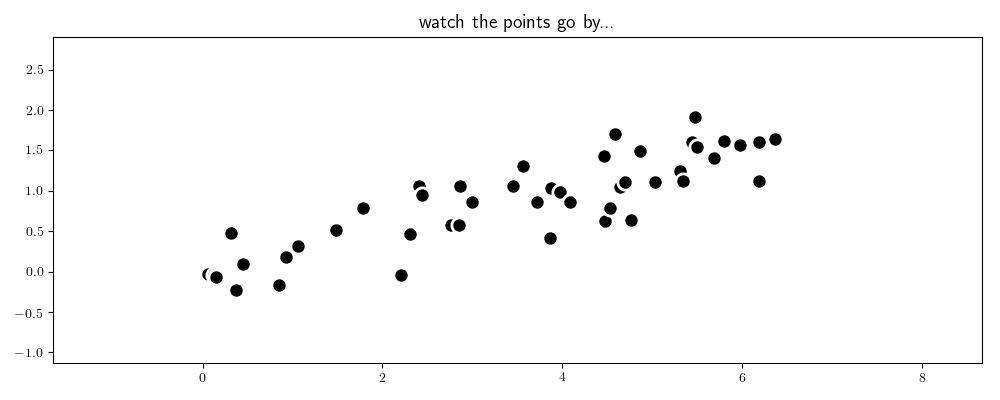
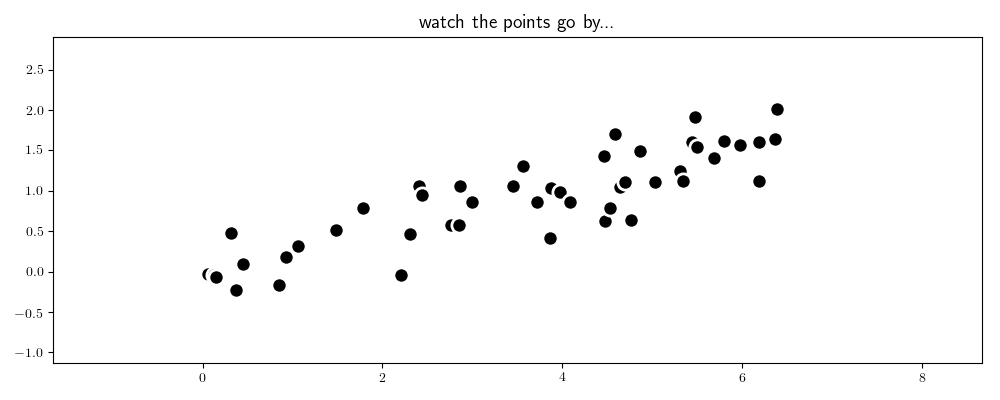
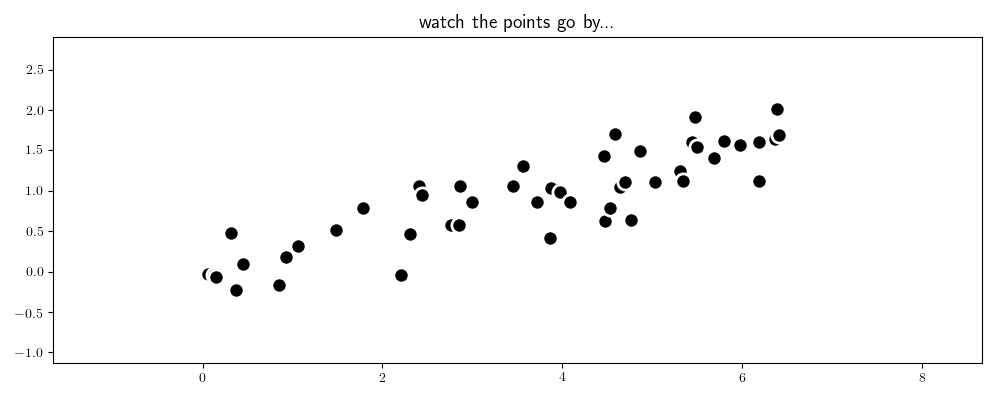
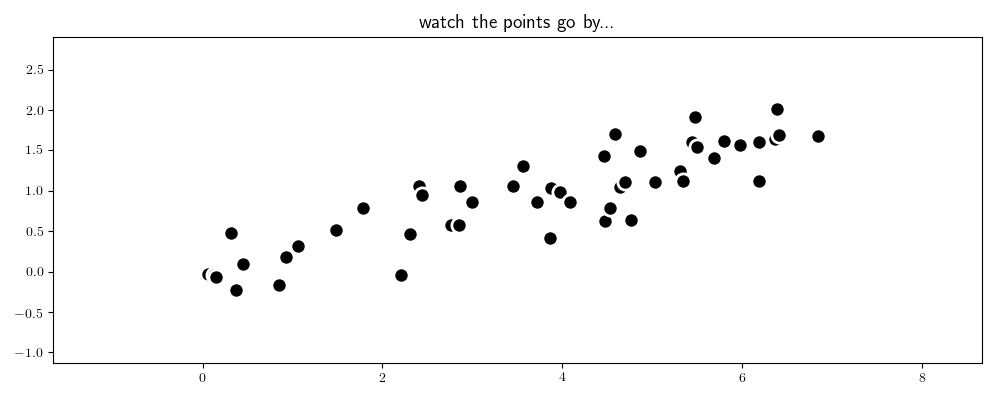

In [20]:
## This code cell will not be shown in the HTML version of this notebook
# animate order
demo1.single_plot(xc,yc)

# Common examples of naturally ordered data

- **time** naturally orders the arrival of tons of data
    - time-stamped metadata (e.g., customer X made purchase Y on date Z)
    - financial / economic data
    - natural signals - e.g., electric (e.g., motor output), speech

<figure>
<p>
<img src= '../images/speech_recog_no_output.png' width="50%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em>
</figcaption>
</figure>

# Common examples of naturally ordered data

- **time** naturally orders the arrival of tons of data
    - time-stamped metadata (e.g., customer X made purchase Y on date Z)
    - financial / economic data
    - natural signals - e.g., electric (e.g., motor output), speech

- **text data** e.g., English ordered from left to right

$\,$
$\,$
$\,$

<figure>
<p>
<img src= '../images/dog1.gif' width="50%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em>
</figcaption>
</figure>

# Naturally ordered data and supervised learning

- indeed in many occupations most data is naturally ordered

- you still want to perform supervised learning tasks with such data

- **finance:** predict future (price) value of a commodity
    - **input:** historical series data
    - **output:** future series values

<figure>
<p>
<img src= '../images/rnn_time_series.png' width="80%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <center> <em>  Time series in black, training fit in blue, predictions in green.
    </em> </center>
</figcaption>
</figure>

- **speech recognition:** translate raw audio to text
    - **input:** raw audio 
    - **output:** text translation

<figure>
<p>
<img src= '../images/speech_recog.png' width="70%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <center> <em>   (they're definitely better than cats)
    </em> </center>
</figcaption>
</figure>

- **machine translation:** translate sentence or phrase in one language to another
    - **input:** sentence in language X
    - **output:** sentence in language Y

<figure>
<p>
<img src= '../images/machine_translation.png' width="70%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <center> <em> 
    </em> </center>
</figcaption>
</figure>

# Choose your weapon

- how do you include natural ordering in your model?

- **autoregressive modeling:** process data so its no longer naturally ordered, and treat as "standard" 
    - use a "sliding window" --> e.g., *moving average* with time series, convolution networks for speech

- **recurrent neural networks: (RNNs)** go back to the drawing board and come up with new models that incorporate natural order
    - these models are collectively referred to as "dynamic systems with hidden states"

- both commonly used, and often <a href="http://www.offconvex.org/2018/07/27/approximating-recurrent/" target="_blank">compete for dominance</a> in terms of effectiveness and popularity




- we're here to talk about the latter!

# What is an RNN?  The typical origin story

- a typical origin story for RNNs echoed throughout the internet goes like this

    - "RNNs have infinite memory"
    - "an RNN is just a <a href="https://jermwatt.github.io/mlrefined/blog_posts/13_Multilayer_perceptrons/13_1_Multi_layer_perceptrons.html" target="_blank">feedforward network</a>  with self-loops / multiple copies of the same network with each passing to the next in succession"


<figure>
<p>
<img src= '../images/rnn_nature.jpg' width="70%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em> 
</figcaption>
</figure>

[source](https://www.nature.com/articles/nature14539)

- true statements, but not helpful if you don't already know what you're talking about

- like picking up a <a href="http://www.swordsofmight.com/product/double-headed-larp-battle-axe/" target="_blank">battle axe</a>  blade first


<figure>
<p>
<img src= '../images/battle_axe.png' width="34%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em> 
</figcaption>
</figure>

- never pick up your weapons blade-first

# Think by analogy

- did you learn what a line / hyperplane was before using it as a regressor / classifier?

$$
\text{model}\left(x,\Theta\right) = w_0 + xw_1
$$

- did you learn what a polynomial was before using it as a <a href="https://jermwatt.github.io/mlrefined/blog_posts/11_Feature_learning/11_2_BiasVariance.html" target="_blank">regressor / classifier</a> ? e.g.,

$$
\text{model}\left(x,\Theta\right) = w_0 + xw_1 + x^2w_2 + \cdots + w_Bx^B
$$


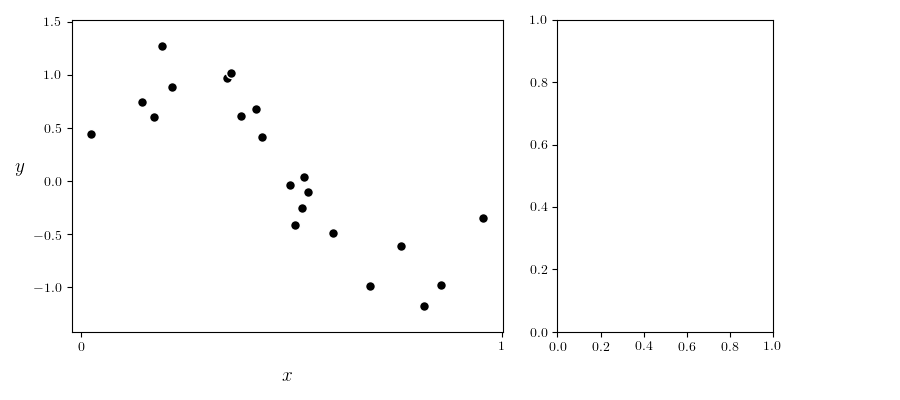
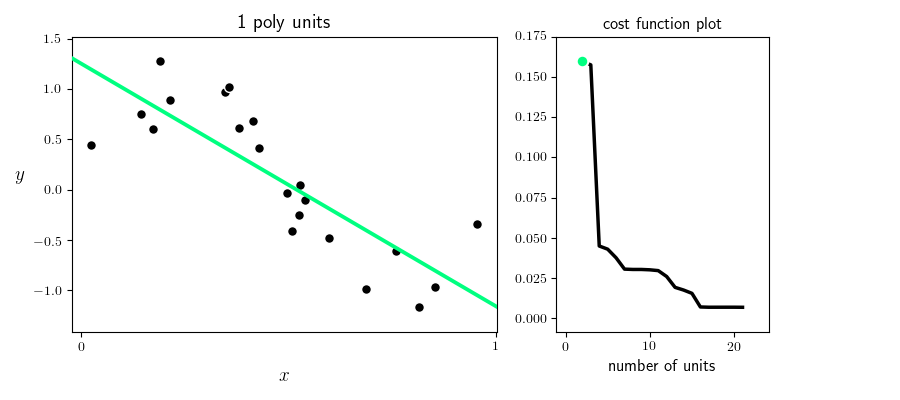
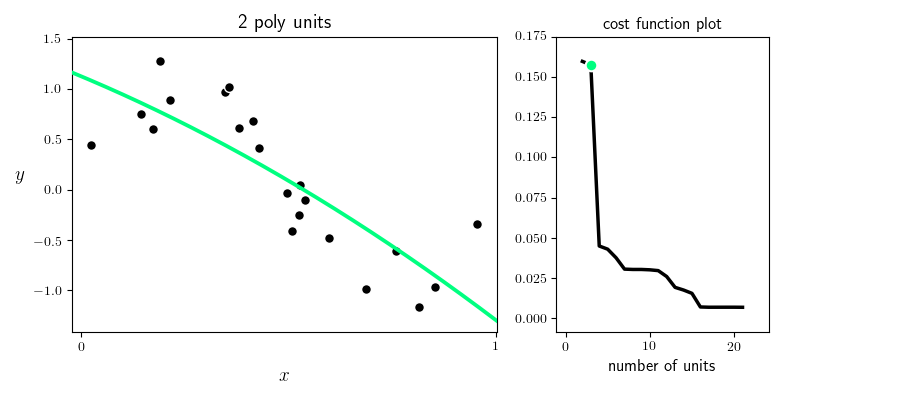
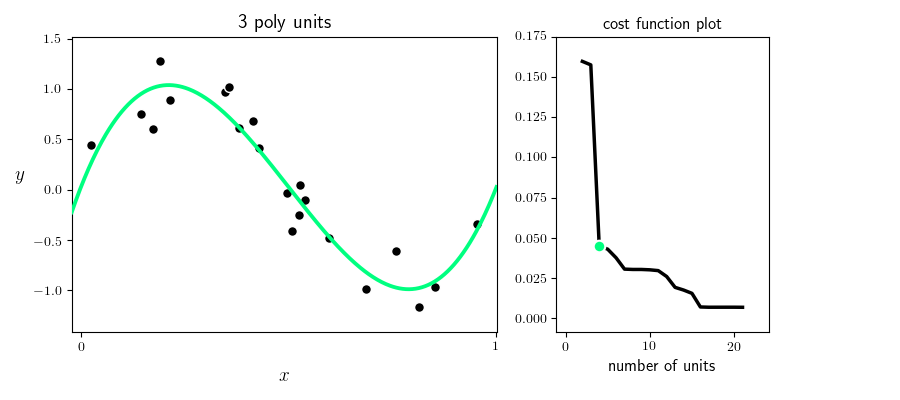
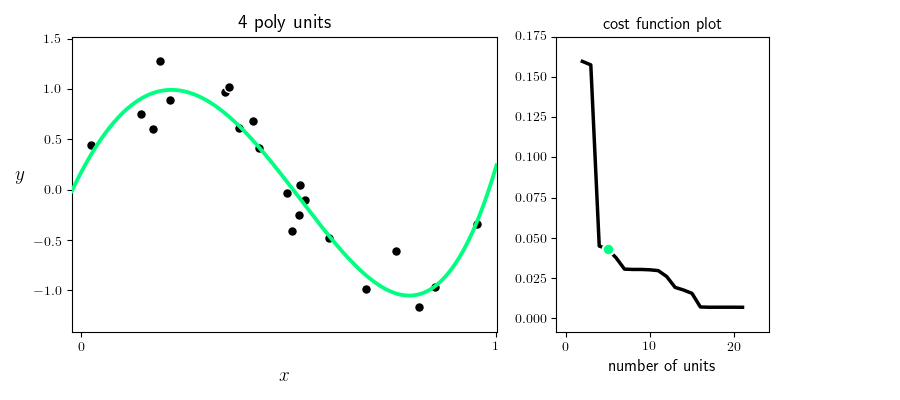
...
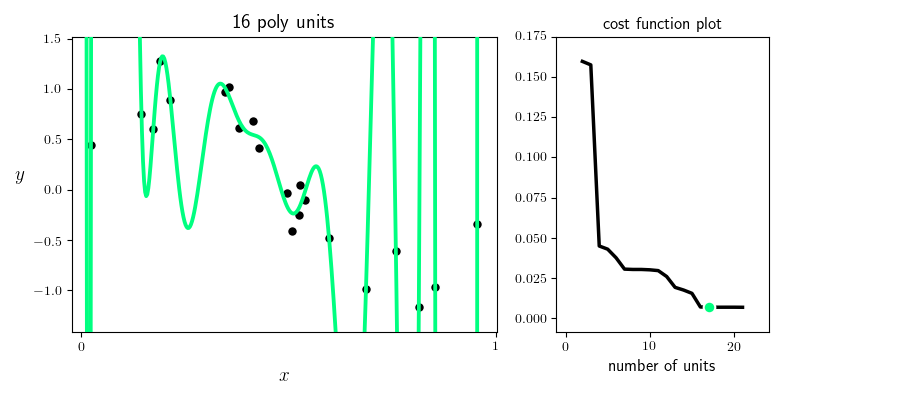
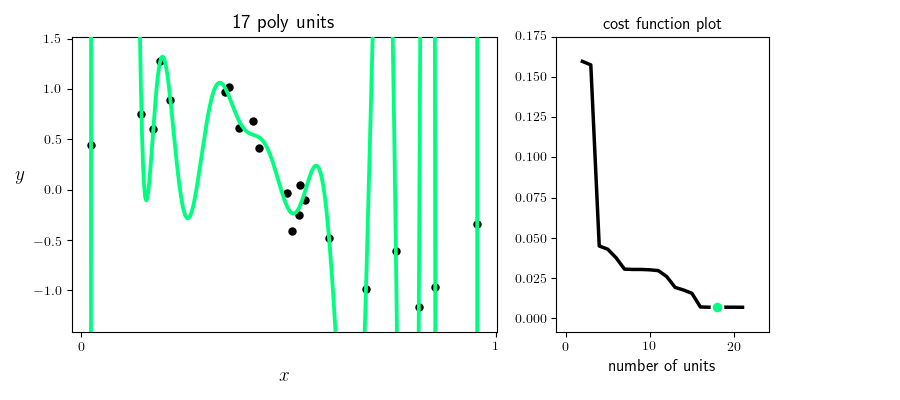
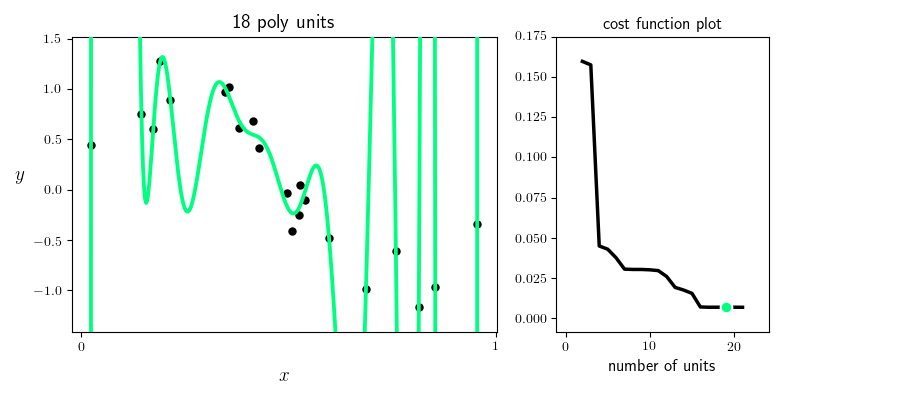
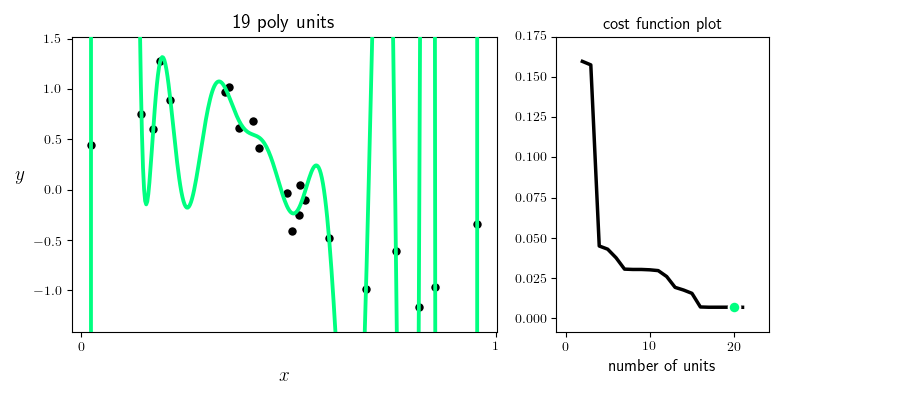
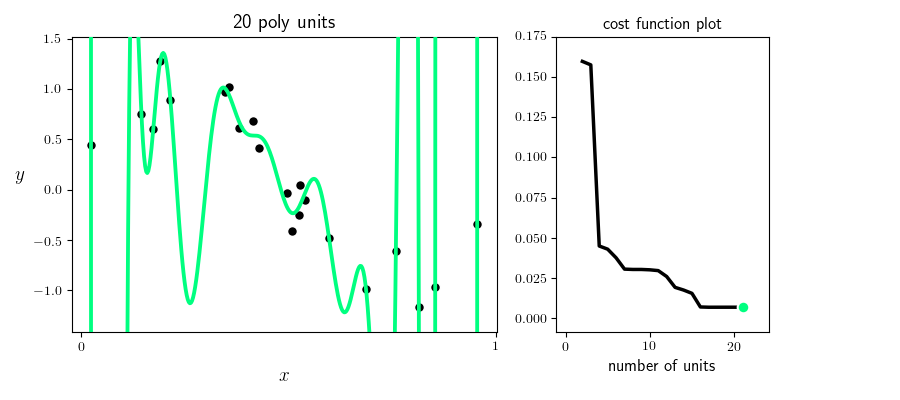

In [16]:
## This code cell will not be shown in the HTML version of this notebook
demo2 = nonlib.regression_basis_single.Visualizer()
csvname = datapath + 'noisy_sin_sample.csv'
demo2.load_data(csvname)
demo2.browse_single_fit(basis='poly',num_units = [v for v in range(1,21,1)])

- did you learn what a <a href="https://jermwatt.github.io/mlrefined/blog_posts/13_Multilayer_perceptrons/13_1_Multi_layer_perceptrons.html" target="_blank">feedforward network architecture</a>  was before using it as a regressor / classifier?  e.g., a single layer network


$$
\text{model}\left(x,\Theta\right) = w_0 + \text{tanh}\left(w_{1,0} + xw_{1,1}\right)w_1 + \cdots + \text{tanh}\left(w_{1,B} + xw_{1,B}\right)w_B
$$

In [37]:
# model employing fully connected network
# params packaged as: theta = [internal_network, final_linear_combo]
def model(x,theta):    
    # pass input through network 
    f = network_pass(x,theta[0])
    
    # compute final linear combination and return
    a = theta[1][0] + np.dot(f.T,theta[1][1:])
    return a.T

In [ ]:
# guts of a fully connected network
def network_pass(a, w):    
    # loop through each layer matrix
    for W in w:
        # compute inner product with current layer weights
        a = W[0] + np.dot(a.T, W[1:])

        # output of layer activation
        a = activation(a).T
    return a


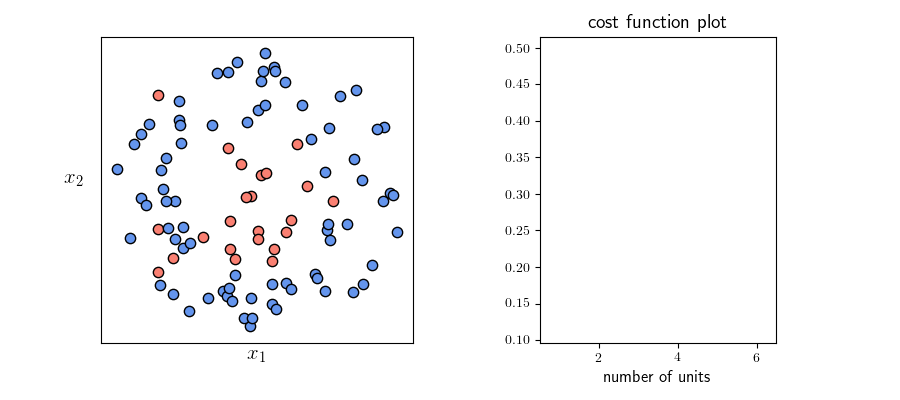
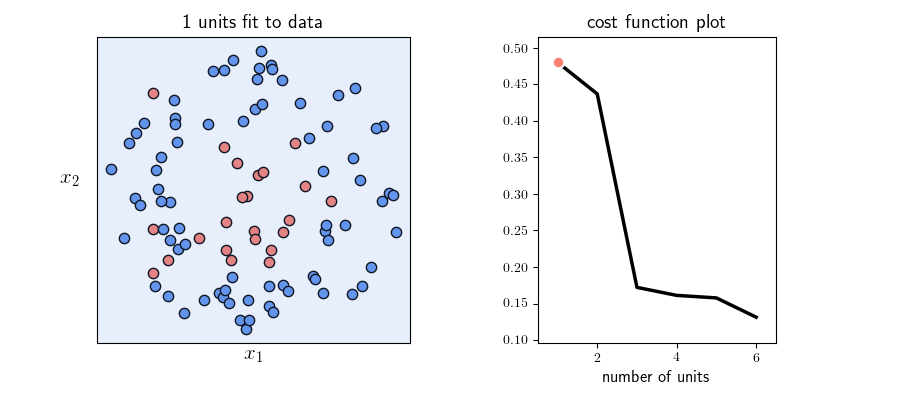
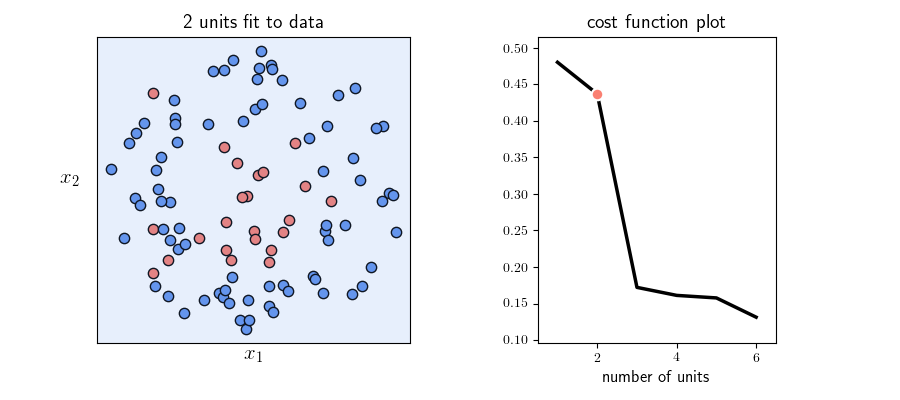
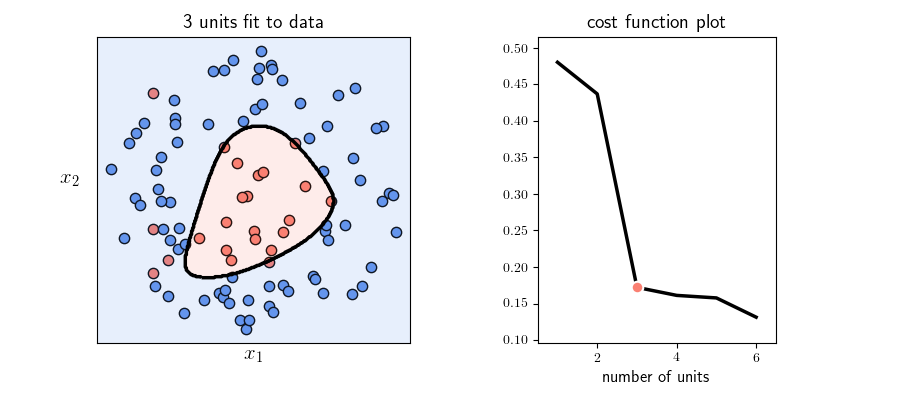
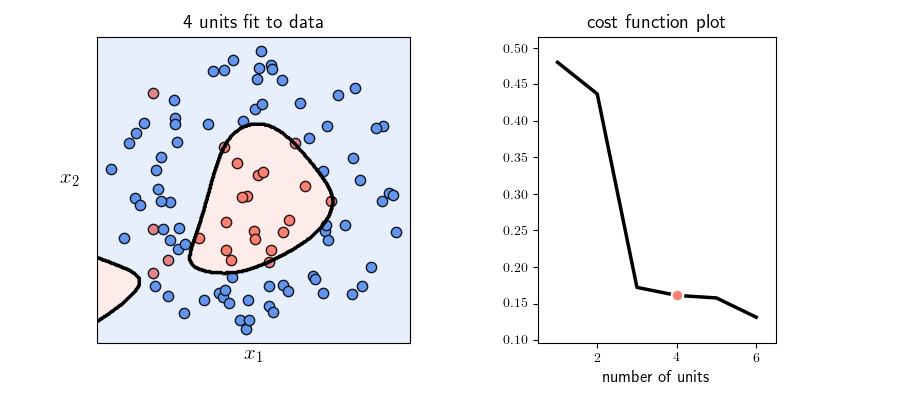
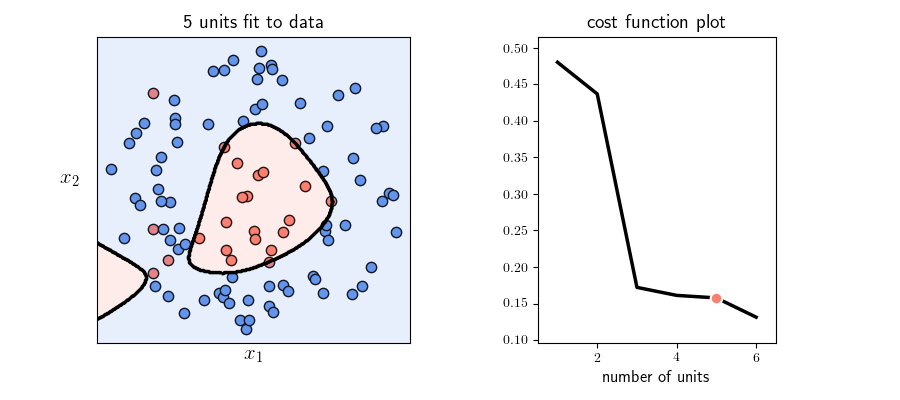
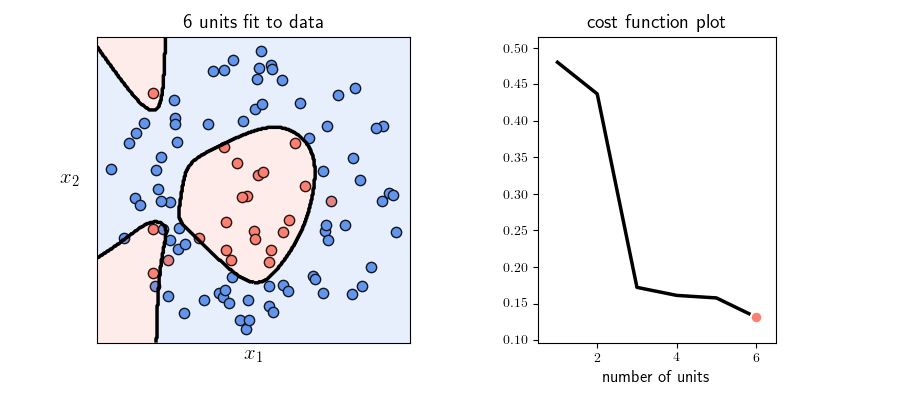

In [21]:
## This code cell will not be shown in the HTML version of this notebook
# load in 
import copy
from mlrefined_libraries import nonlinear_superlearn_library as nonlib
import autograd.numpy as np

# the mid-point between each set of consecutive inputs along each input dimension
csvname = datapath + 'new_circle_data.csv'
data = np.loadtxt(csvname,delimiter = ',')
x = data[:-1,:]
y = data[-1:,:]

### boosting ###
num_units = 6
run1 = []
for j in range(num_units):
    #print ('fitting ' + str(j + 1) + ' units')
    
    # import the v1 library
    mylib1 = nonlib.library_v1.superlearn_setup.Setup(x,y)

    # choose features
    mylib1.choose_features(name = 'multilayer_perceptron',layer_sizes = [2,j+1,1],activation = 'tanh')

    # choose normalizer
    mylib1.choose_normalizer(name = 'standard')

    # choose cost
    mylib1.choose_cost(name = 'softmax')

    # fit an optimization
    mylib1.fit(max_its = 2000,alpha_choice = 10**(0),optimizer = 'gradient descent')

    # add model to list
    run1.append(copy.deepcopy(mylib1))
    
# animate the business
frames = num_units
demo4 = nonlib.main_classification_animators.Visualizer(csvname)
demo4.animate_classifications(run1,frames)

- lets do that here with RNNs - lets study the models first

# Dynamic systems with hidden states

In [ ]:
import sys
sys.path.append('../')

import numpy as np
import library.animators as anim

# This is needed to compensate for %matplotlib notebook's tendancy to blow up images when plotted inline
%matplotlib notebook
from matplotlib import rcParams
rcParams['figure.autolayout'] = True

%load_ext autoreload
%autoreload 2

## Examples


- lets bash our brains in with examples 

- for simplicity lets deal with ordered input data of the form


$$
x_1,\,x_2,\,x_3,\,...,x_{t},\,...
$$

- in this sequence $x_1$ comes first, and before $x_2$, $x_2$ comes before $x_3$, etc.,


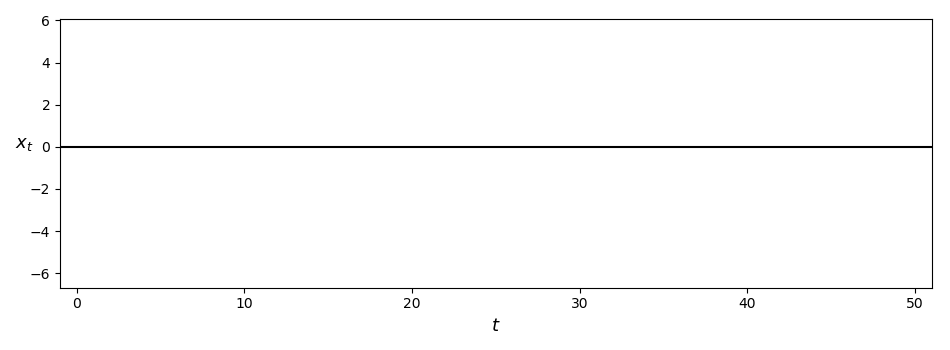
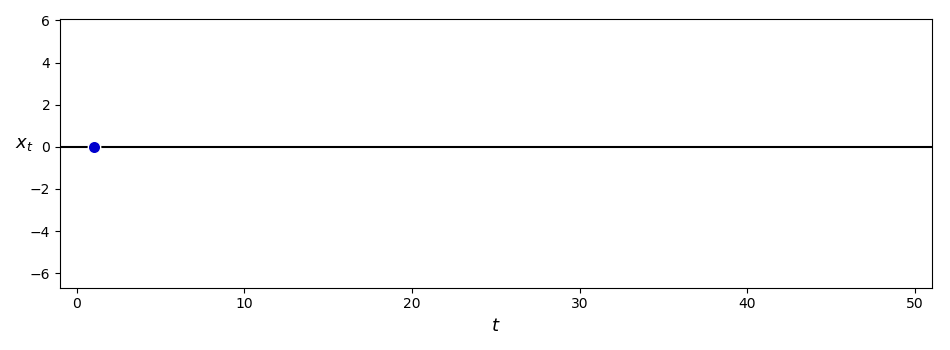
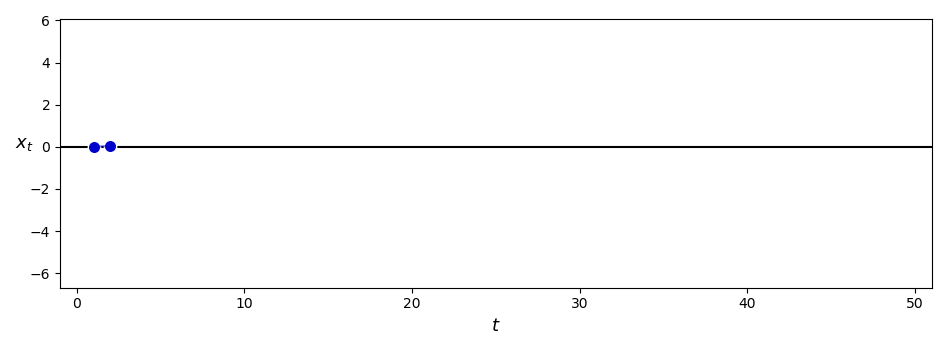
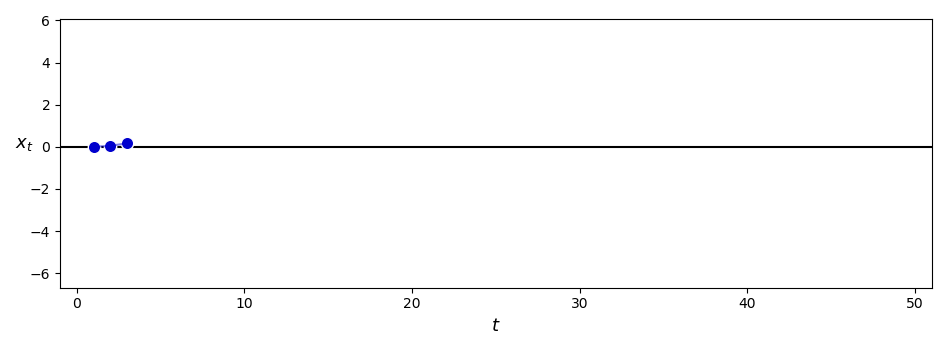
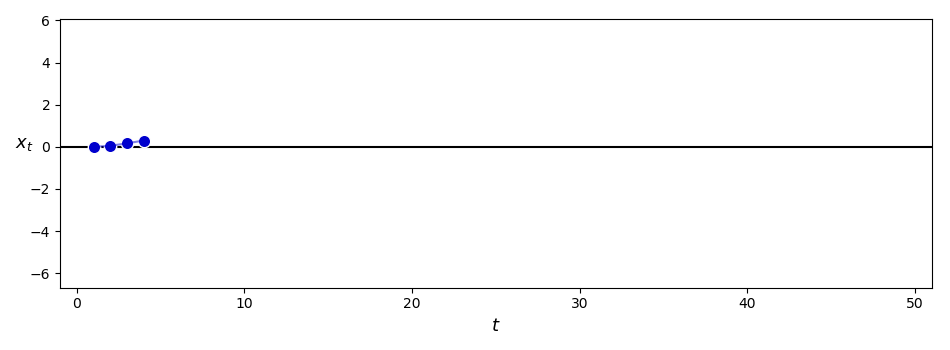
...
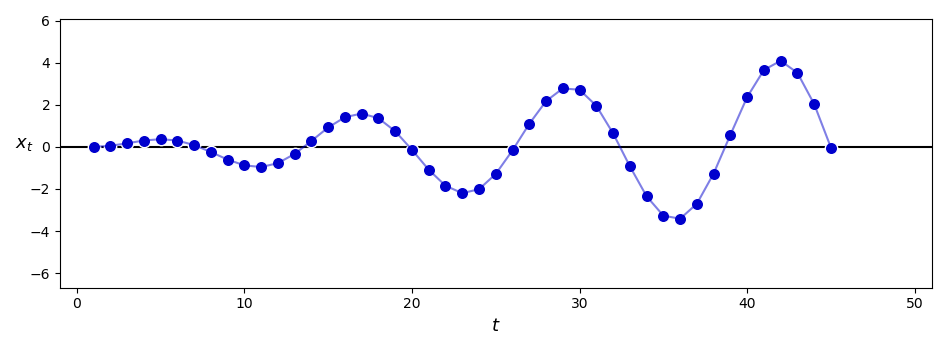
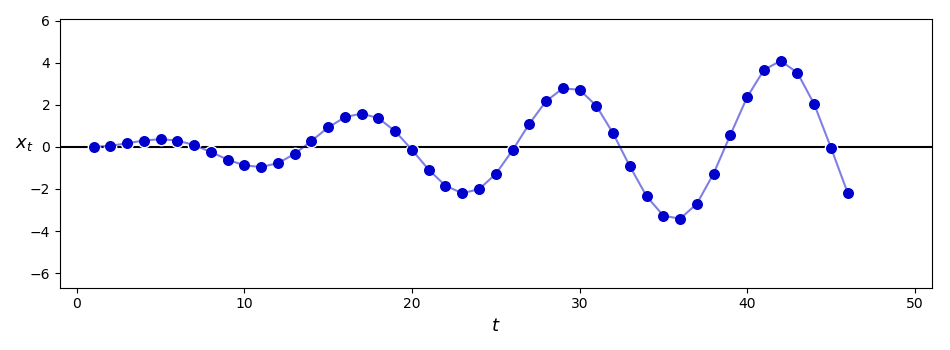
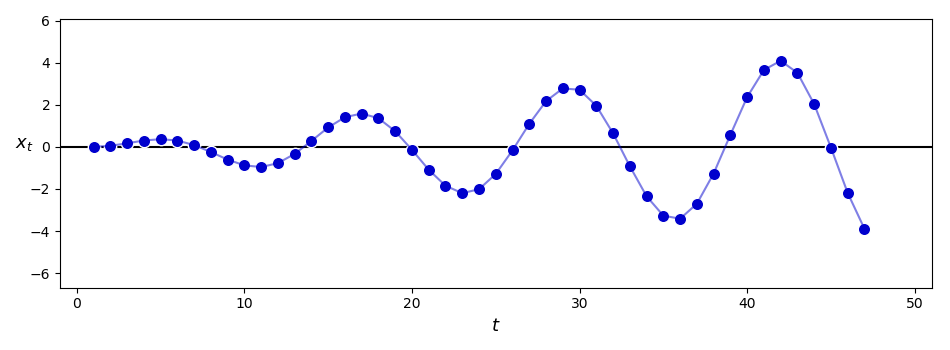
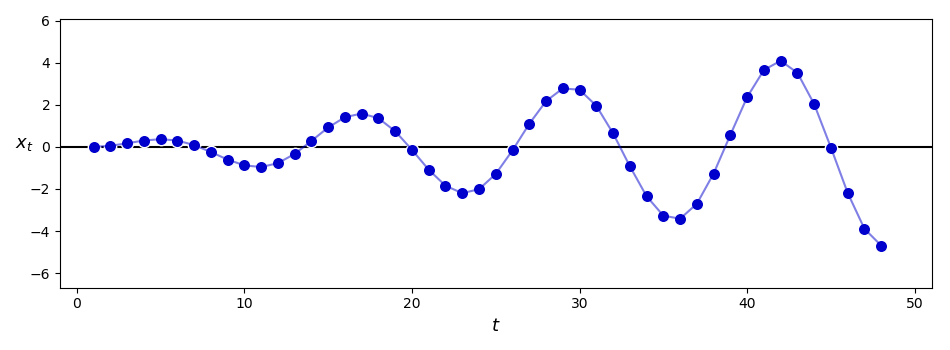
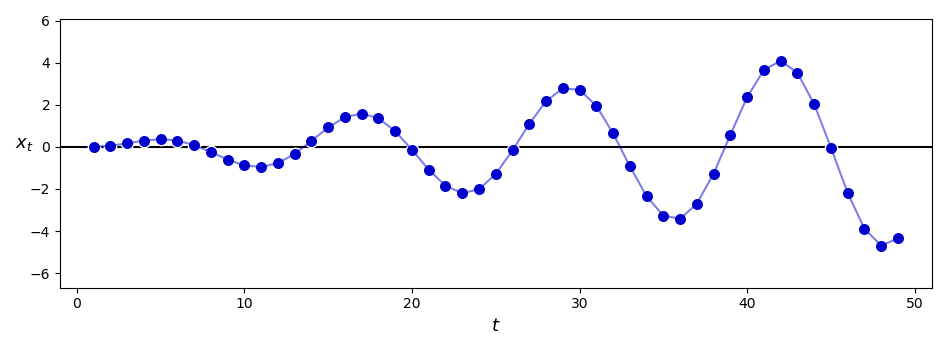

In [5]:
## This code cell will not be shown in the HTML version of this notebook
# an example input sequence of ordered data 
x = []
for t in range(50):
    x_t = 0.1*t*np.sin(0.5*t)
    x.append(x_t)    
    
plotter = anim.plot_input.Plotter()
animator = anim.history_animators.Animator()
animator.animate_plot(plotter,x,[],num_frames = 100)

## Jargon tear-down time

- we want to understand what a "dynamic system with hidden states" is, lets take the jargon-phrase apart

- first: what is a "dynamic system"?  

- its just a function that takes in elements of our input sequence and produces an output

## Just the "dynamic systems" part


- so a dynamic system taking in a single element generally looks like

$$
h_t = f\left(x_t\right)
$$

- to state the obvious: $h_t$ a function of $x_t$, and $x_t$ alone

- a simple example:  $h_t = -2x_t + 1$


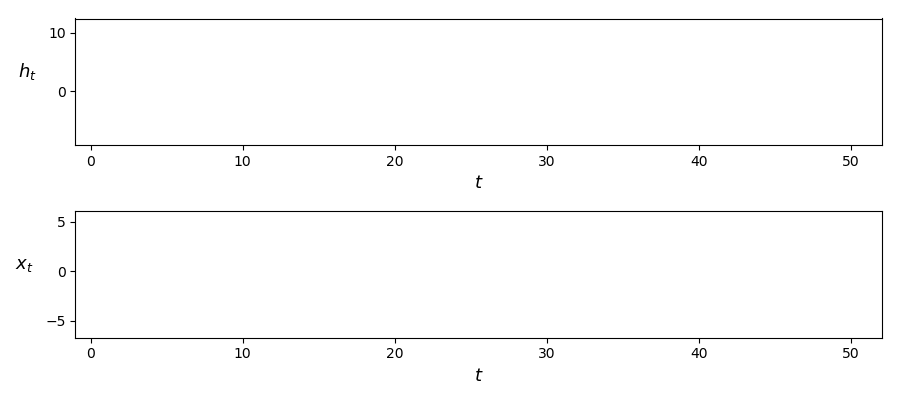
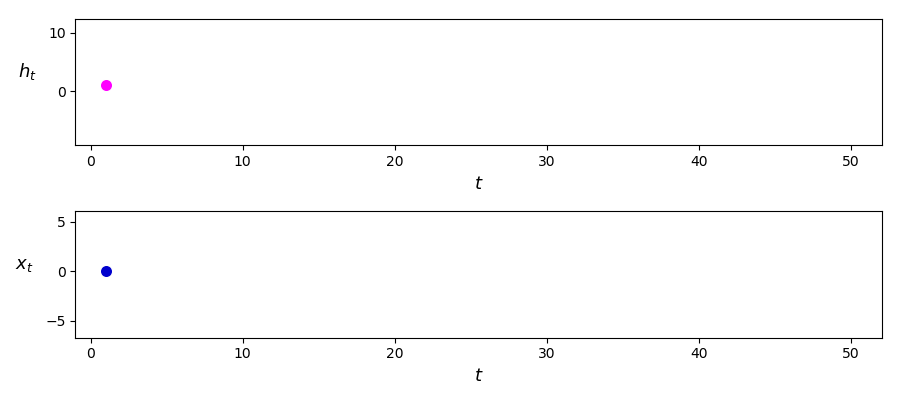
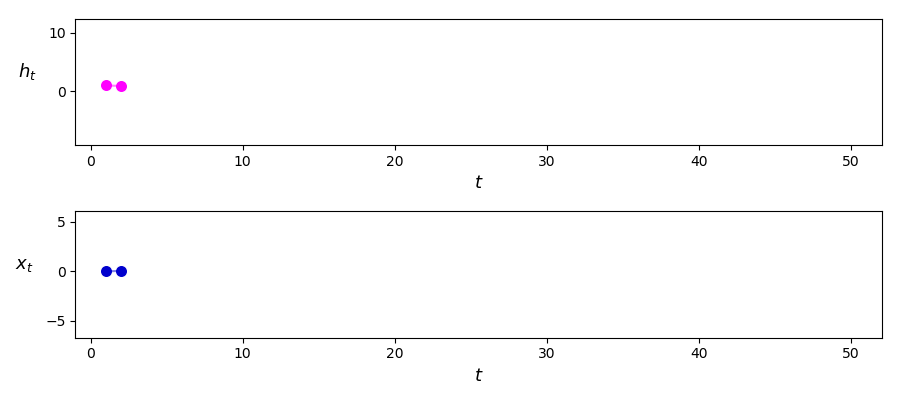
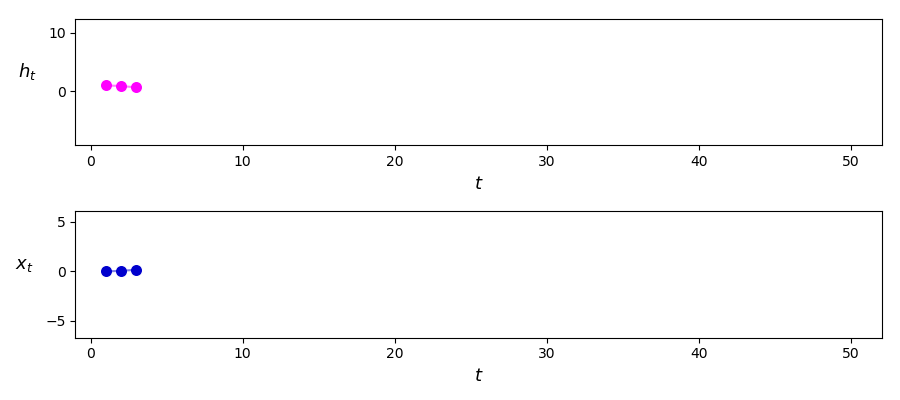
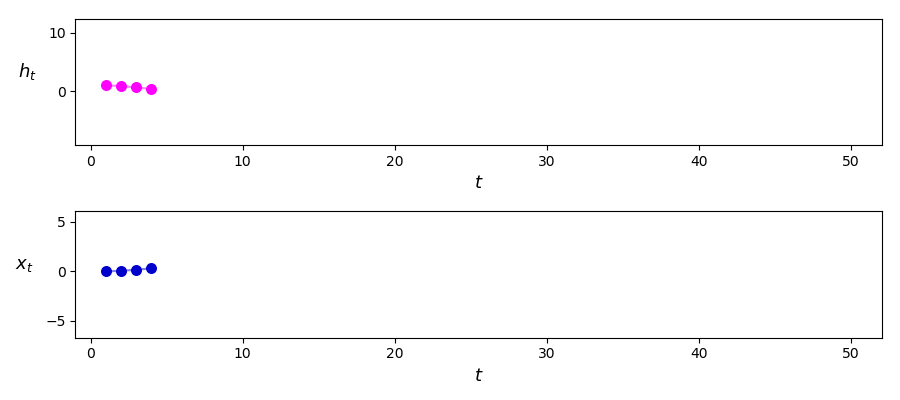
...
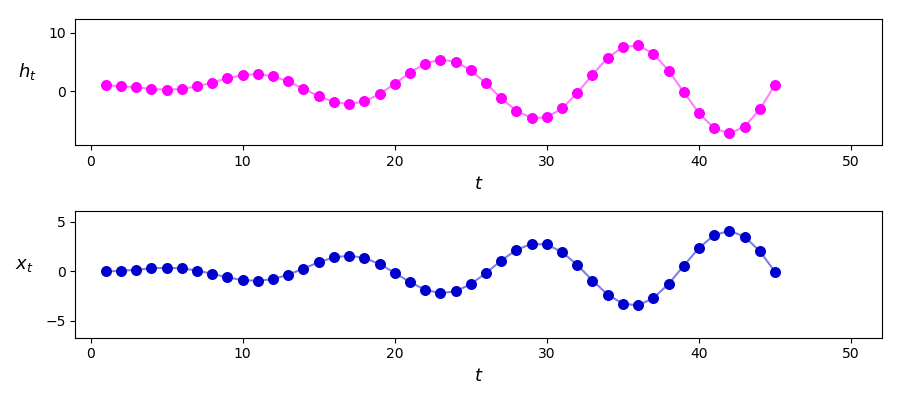
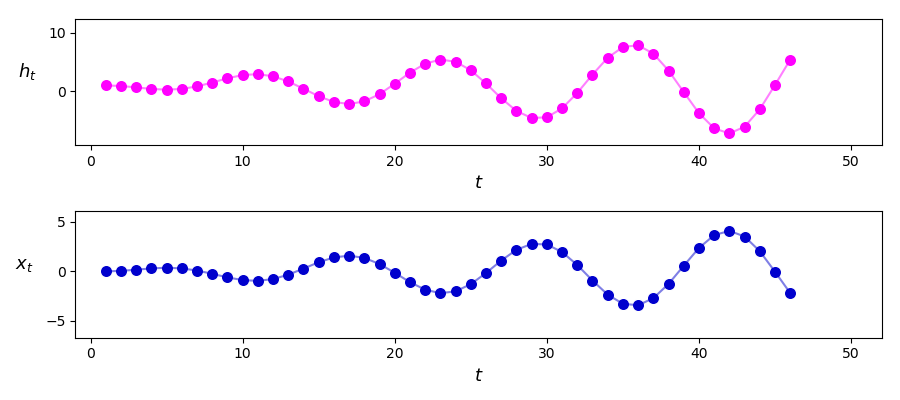
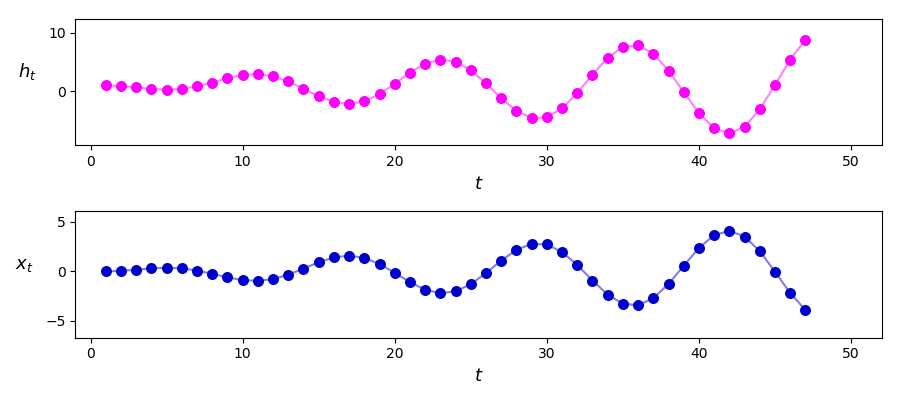
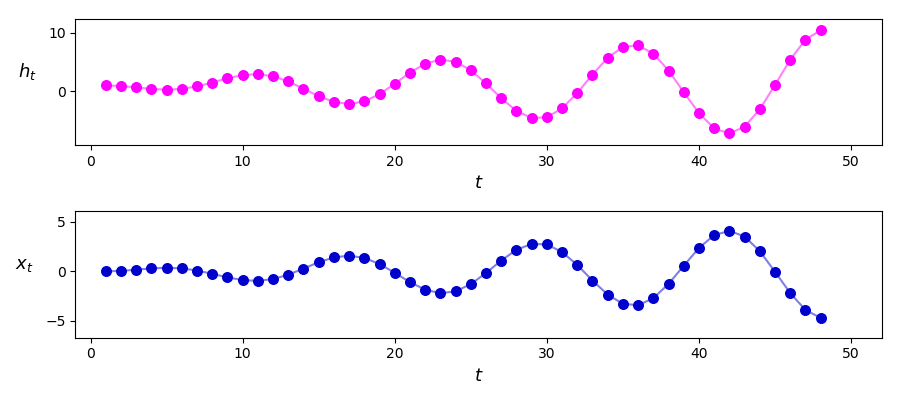
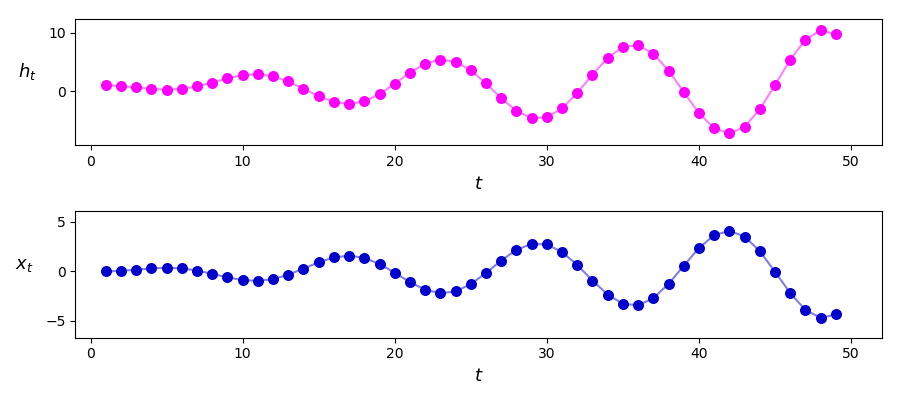

In [25]:
## This code cell will not be shown in the HTML version of this notebook
# an example input sequence of ordered data 
x = []
for t in range(50):
    x_t = 0.1*t*np.sin(0.5*t)
    x.append(x_t)    

# compute negative 
h = []
for t in range(50):
    x_t = x[t]
    h_t = -2*x_t + 1
    h.append(h_t)    
    
plotter = anim.plot_input_with_hidden_separate.Plotter()
animator = anim.history_animators.Animator()
animator.animate_plot(plotter,x,h,num_frames = 100)

## Now the "hidden" part

- a dynamic system with a "hidden state" is still a function that takes in elements of our input and produces an output


- however the *output* doesn't just say something about the specific inputs we plug in 

- it also says something about the *entire* input sequence up to and including the specific element(s) we plug in

- that means if we plug in $x_t$ the *output* provides some *summary* (a *count* of some aspect, or a statistic) about the entire input sequence up to that point  $x_1,\,x_2,\,...\,x_t$

#### <span style="color:#a50e3e;">Example 1: Running sums </span> 

- task: compute a *running sum* of our input numbers *on the fly* - i.e., as they arrive


- so when the $t^{th}$ number arrives, compute a sum of the first $t$ numbers $x_1,\,x_2,\,...,x_t$

- lazy solution: when $x_t$ arrives sum up *everything* 

\begin{array}
\
\text{sum of the first $1$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_1 = x_1 \\
\text{sum of the first $2$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_2 = x_1 + x_2 \\
\text{sum of the first $3$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_3 = x_1 + x_2 + x_3 \\
\text{sum of the first $4$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_4 = x_1 + x_2 + x_3 + x_4 \\
\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \\
\text{sum of the first $t$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_{t} = x_1 + x_2 + x_3 + x_4 + \cdots  + x_t \\
\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \\
\end{array}

- obviously super wasteful

- the right way: a simple recursion

<center> <h3>The lazy way</h3> </center>

\begin{array}
\
\text{sum of the first $1$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_1 = x_1 \\
\text{sum of the first $2$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_2 = x_1 + x_2 \\
\text{sum of the first $3$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_3 = x_1 + x_2 + x_3 \\
\text{sum of the first $4$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_4 = x_1 + x_2 + x_3 + x_4 \\
\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \\
\text{sum of the first $t$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_{t} = x_1 + x_2 + x_3 + x_4 + \cdots  + x_t \\
\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \\
\end{array}

<center> <h3>The right way</h3> </center>

\begin{array}
\
\text{sum of the first $1$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_1 = x_1 \\
\text{sum of the first $2$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_2 = h_1 + x_2 \\
\text{sum of the first $3$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_3 = h_2 + x_3 \\
\text{sum of the first $4$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_4 = h_3 + x_4 \\
\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \\
\text{sum of the first $t$ elements:} \,\,\,\,\,\,\,\,\,\,\,\,\, h_{t} = h_{t-1} + x_t \\
\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\,\, \vdots \\
\end{array}

<figure>
<p>
<img src= '../images/counting_comparison.png' width="100%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <center> <em>   
    </em> </center>
</figcaption>
</figure>

#### <span style="color:#a50e3e;">Example 1:</span>   Running sums 

- general recursion $h_t = h_{t-1} + x_t$ very effecient way to compute running sums, only $h_{t-1}$ and $x_t$ need be stored

- $h_t$ is called a **hidden state** of the system, it "summarizes" $x_1,\,x_2,\,...,x_t$ by literally *summing* them up

$$
h_t = h_{t-1} + x_t = x_1 + x_2 + \cdots + x_t
$$

- general formula of dynamic system with hidden state

$$
h_t = f\left(h_{t-1},x_t \right)
$$

- compare to general dynamic system without hidden state

$$
h_t = f\left(x_t\right)
$$

- general formula of dynamic system with hidden state

$$
h_t = f\left(h_{t-1},x_t \right)
$$


- $h_t$ recurses on itself, allows it to act as a "summary" or "accumulator" variable, capturing something about the entire input sequence $x_1,\,x_2,\,...,x_t$ 


- exactly what that "something" is depends on how you define the function $f$

#### <span style="color:#a50e3e;">Example 2: </span>  Running mean 


- the same idea falls out when computing a running *mean* 


- when $x_t$ arrives we want to compute $h_t = \frac{x_1 + x_2 + \cdots + x_t}{t}$ effeciently

- <a href="https://jermwatt.github.io/mlrefined/blog_posts/3_First_order_methods/3_7_Momentum.html" target="_blank">a little tinkering</a> gets you the recursion: $h_t = \frac{t-1}{t}h_{t-1} + \frac{1}{t}x_t$





- dynamic system with hidden state $h_t$ which *summarizes* $x_1,\,x_2,\,...,x_t$ as its *mean*

#### <span style="color:#a50e3e;">Example 3: </span>  Exponential average

- [](https://jermwatt.github.io/mlrefined/blog_posts/3_First_order_methods/3_7_Momentum.html) a basic generalization of the running mean $h_t = \frac{t-1}{t}h_{t-1} + \frac{1}{t}x_t$ is called the *exponential average*

$$
h_t = \alpha h_{t-1} + (1 - \alpha) x_t
$$

$\,\,\,$ where $0 \leq \alpha \leq 1$

- if you roll back the recursion you see that $h_t$ *summarizes* the input $x_1,\,x_2,\,...,x_t$ as an <a href="https://en.wikipedia.org/wiki/Exponential_smoothing" target="_blank">exponential average</a> 

- a very common *smoother* built into most electronics for signal processing purposes (<a href="http://sam-koblenski.blogspot.com/2015/09/everyday-dsp-for-programmers-averaging.html" target="_blank">see more here</a>)

- for one particular value of $\alpha$ it smooths like this


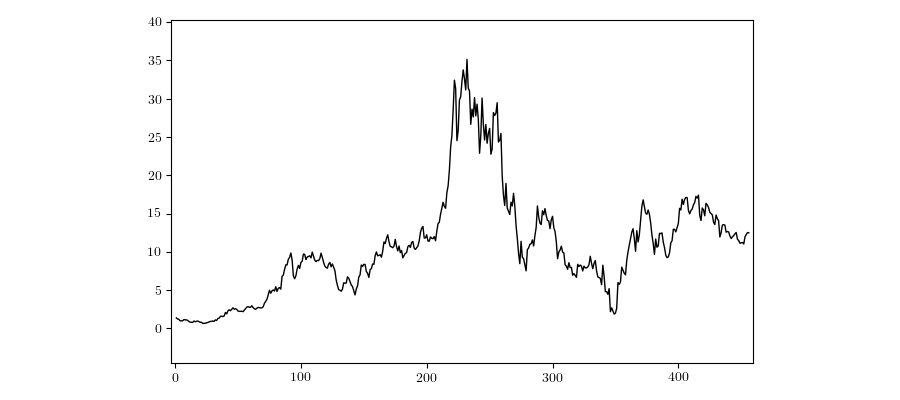
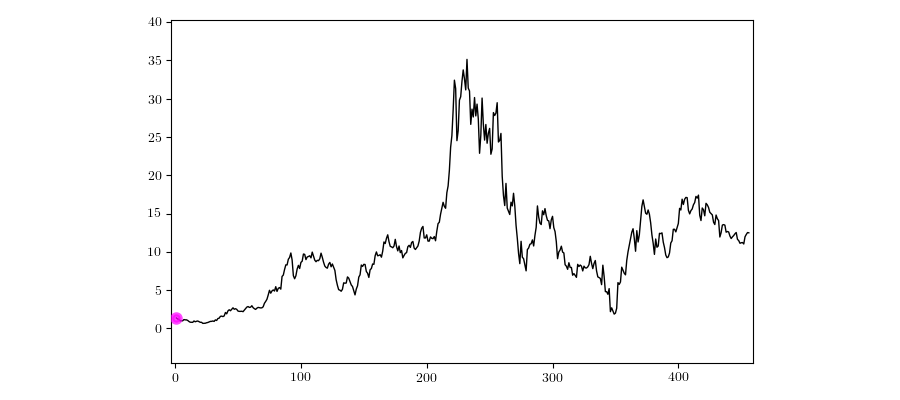
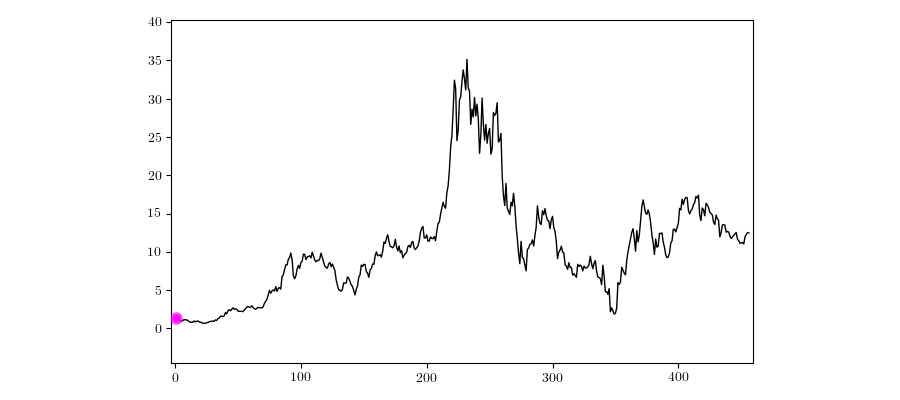
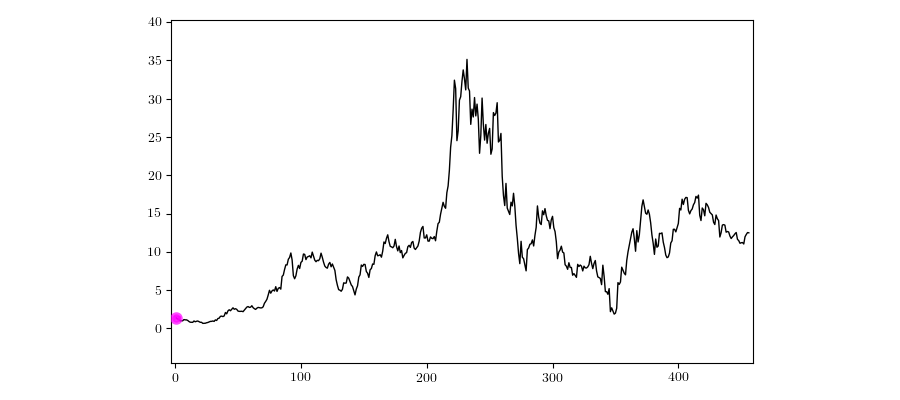
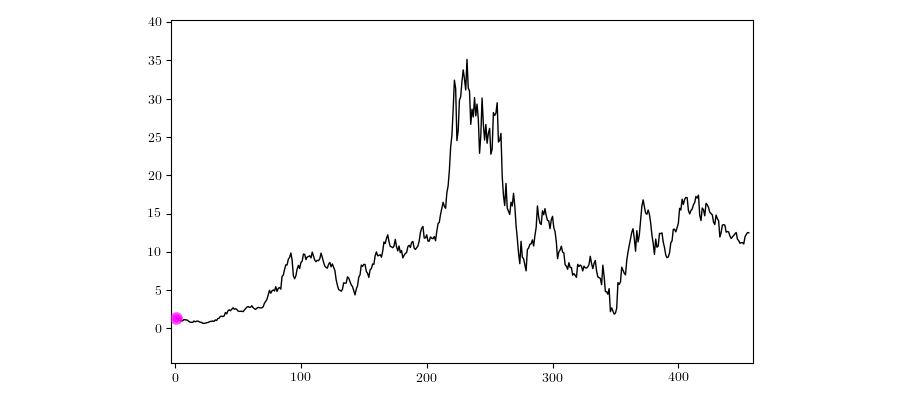
...
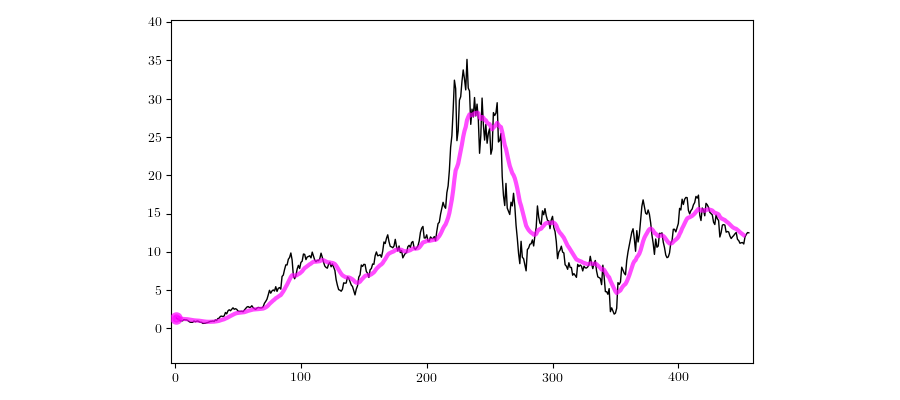
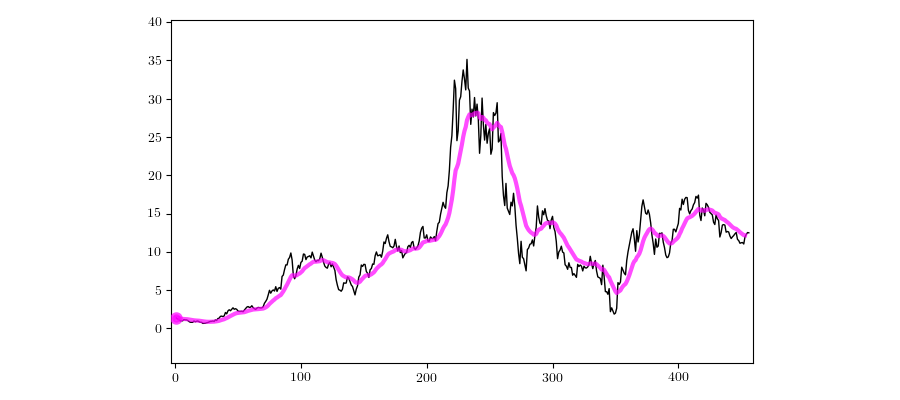
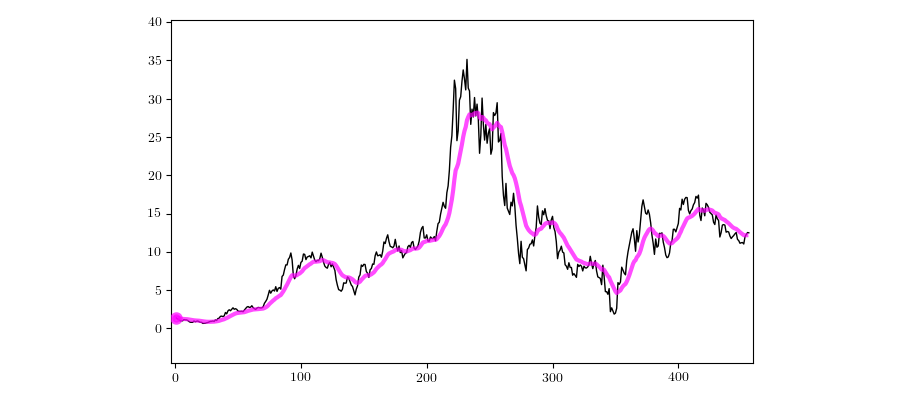
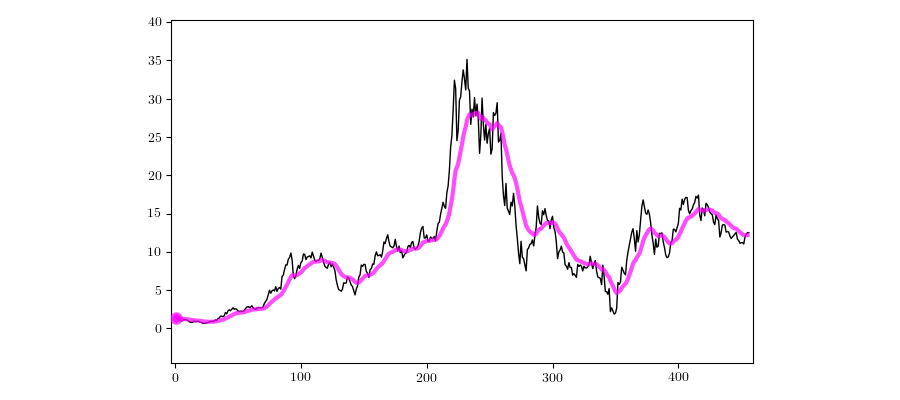
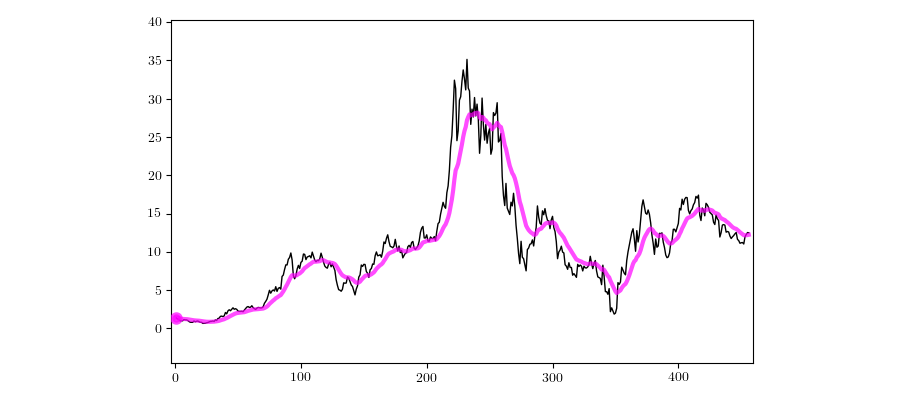

In [26]:
## This code cell will not be shown in the HTML version of this notebook
# load in data
csvname = datapath + 'ford_data.csv'
data = pd.read_csv(csvname)
x = np.array(data['Close'])    # date: 1980 to 2017

# exponential average function
def exponential_average(x,alpha):
    y = [x[0]]
    for p in range(1,len(x)):
        # get current average and point
        ave = y[-1]
        x_p = x[p]

        # make next element
        new_ave = alpha*ave + (1 - alpha)*x_p
        y.append(new_ave)
    return np.array(y)

# produce exponential average time series
alpha = 0.9
y = exponential_average(x,alpha)

# run animator
demo = recurlib.time_series_animators.Visualizer()
demo.animate_running_ave(x,y)

- here's what happens when you mess around with the value of $\alpha$


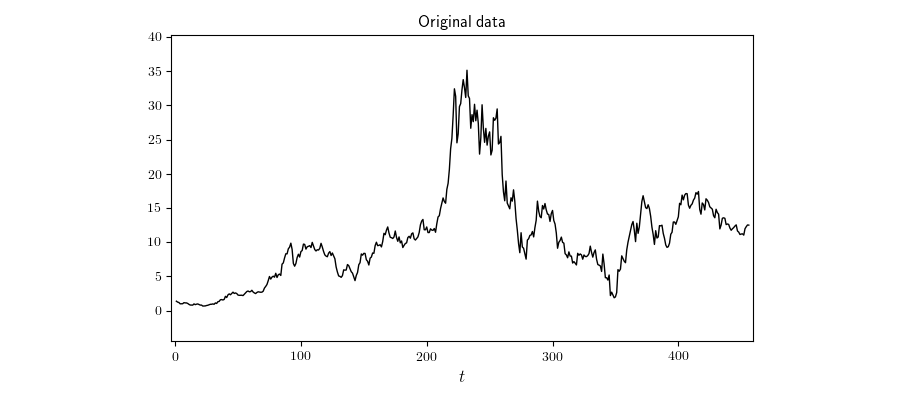
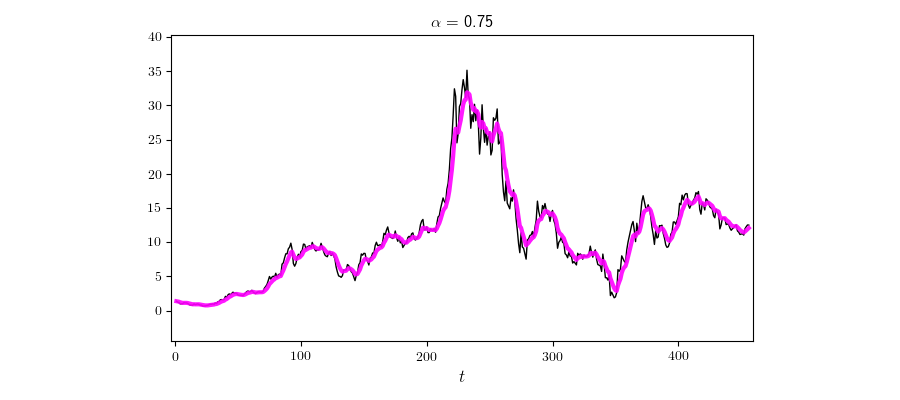
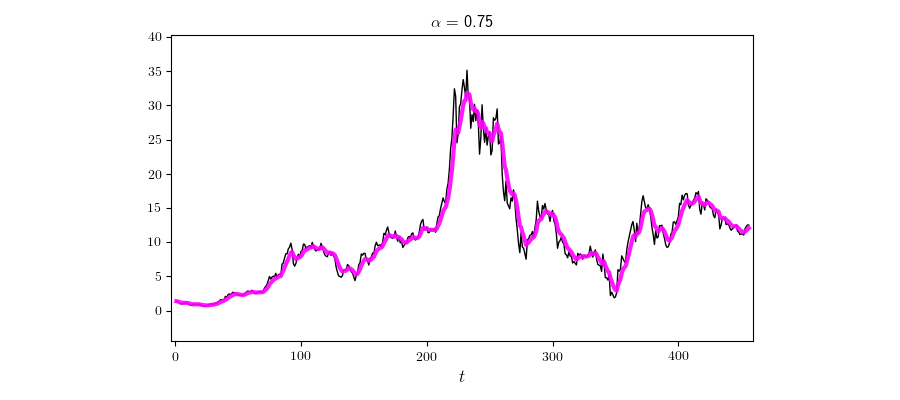
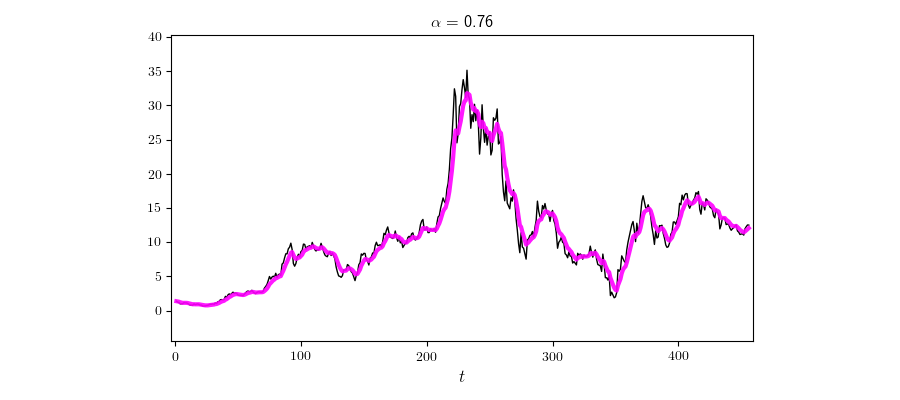
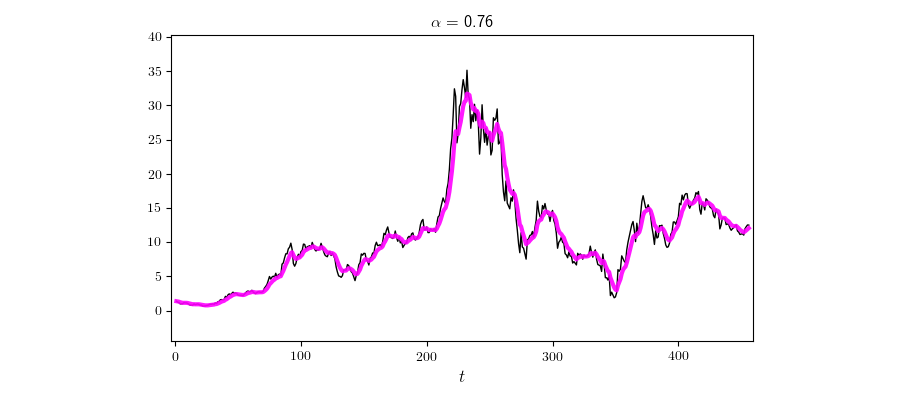
...
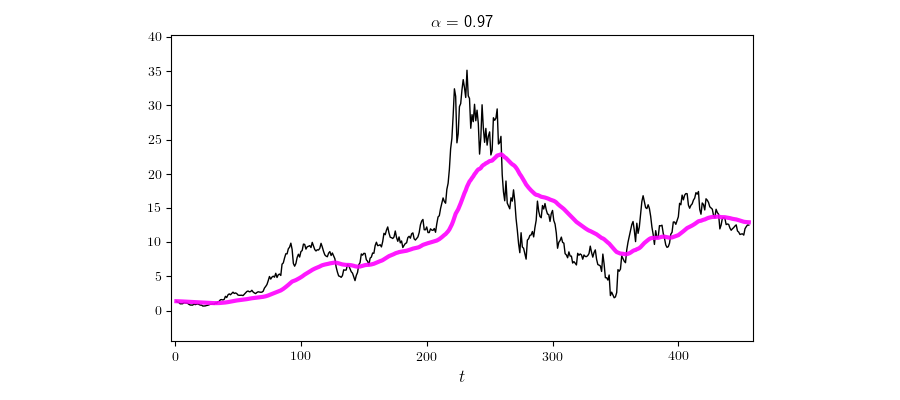
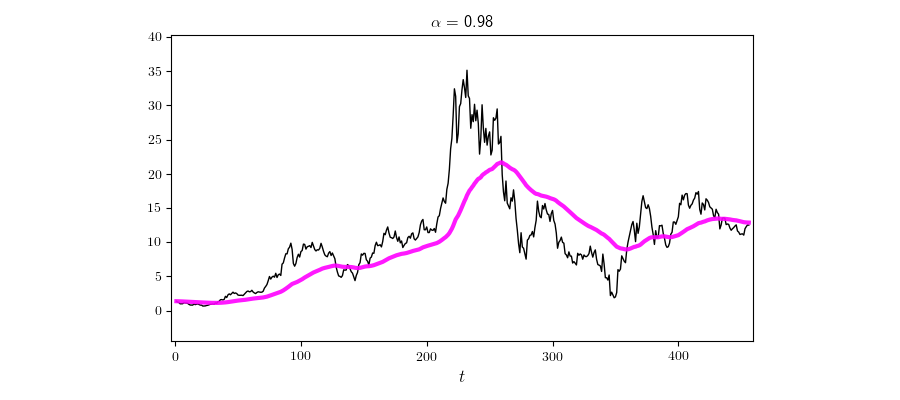
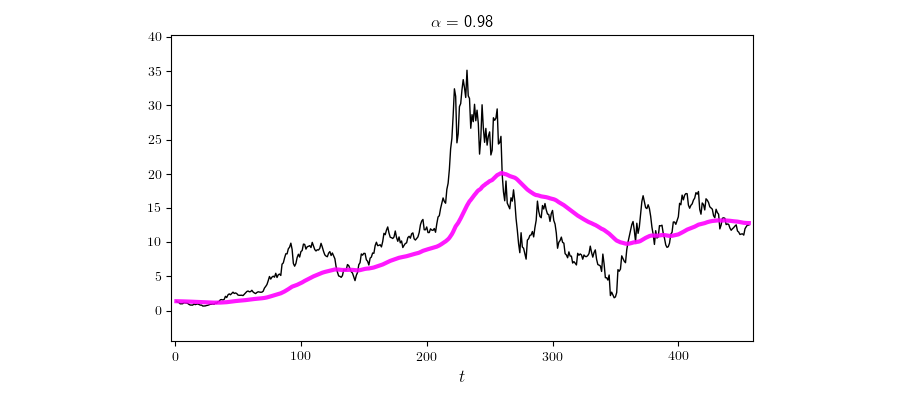
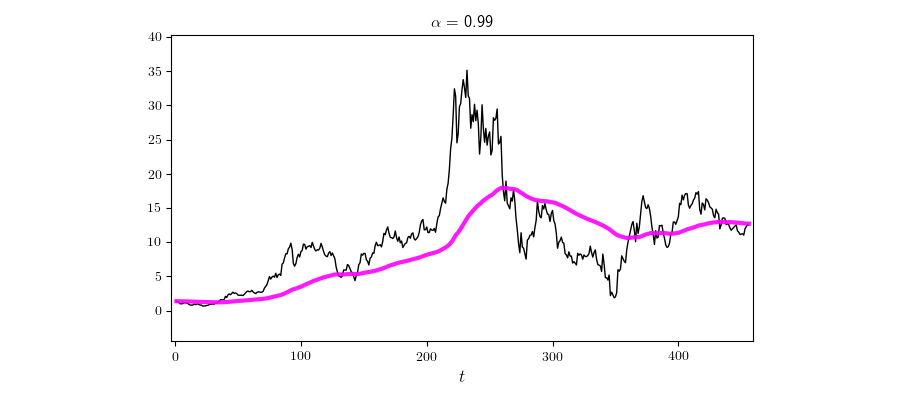
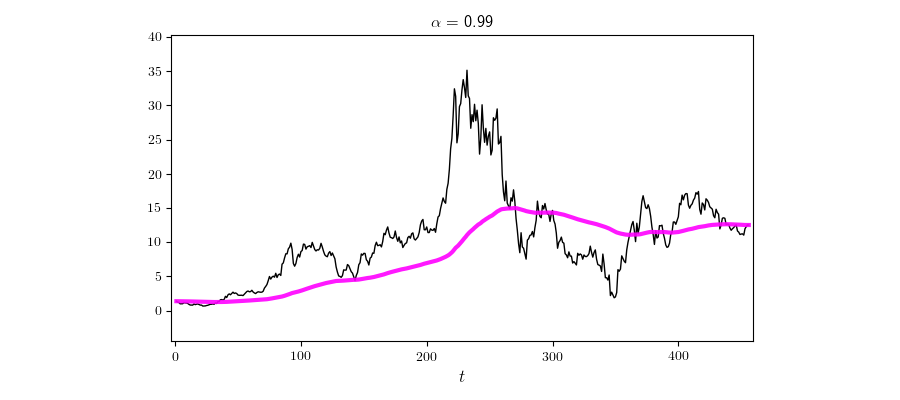

In [33]:
## This code cell will not be shown in the HTML version of this notebook
# load in data
csvname = datapath + 'ford_data.csv'
data = pd.read_csv(csvname)
x = np.array(data['Close'])    # date: 1980 to 2017

# exponential average function
def exponential_average(x,alpha):
    y = [x[0]]
    for p in range(1,len(x)):
        # get current average and point
        ave = y[-1]
        x_p = x[p]

        # make next element
        new_ave = alpha*ave + (1 - alpha)*x_p
        y.append(new_ave)
    return np.array(y)

# produce exponential average time series
params = np.linspace(0.75,0.99,50)

# run animator    
demo = recurlib.time_series_animators.Visualizer()
demo.animate_exponential_average_range(x,exponential_average,params)

#### <span style="color:#a50e3e;">Example 4: </span>  Running maximum 

- compute the maximum on the run, effectively, naturally leads to familiar looking dynamic system with hidden state

$$
h_t = \text{maximum}\left(h_{t-1},x_t\right)
$$

- the hidden state $h_t$ *summarizes* the input $x_1,\,x_2,\,...,x_t$ by its *maximum value*


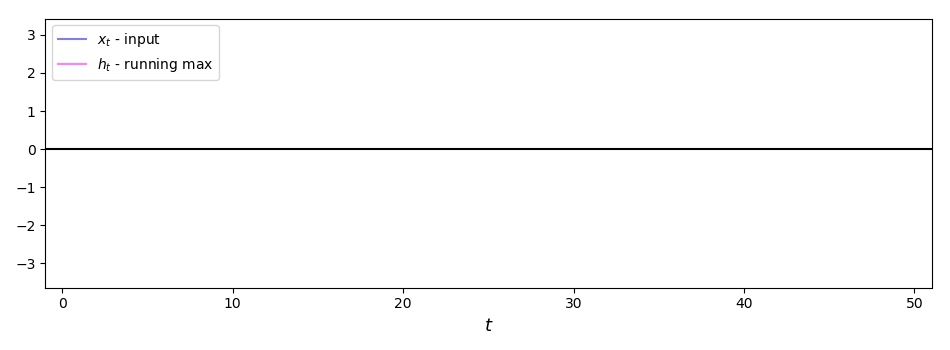
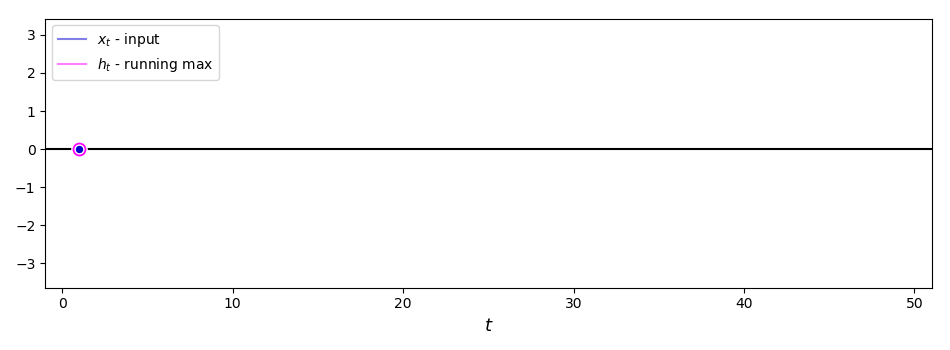
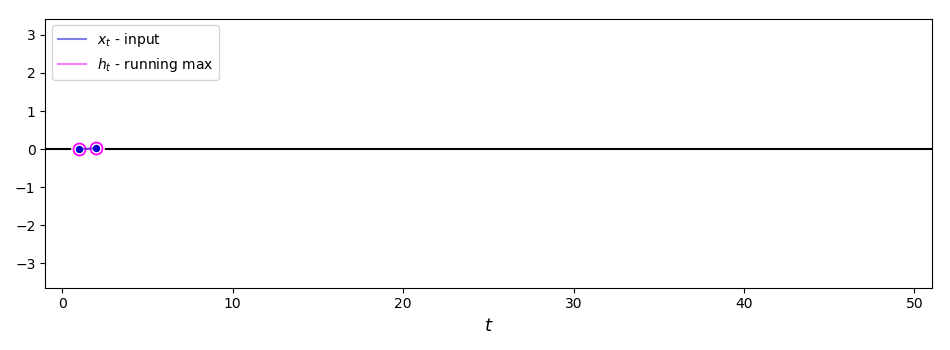
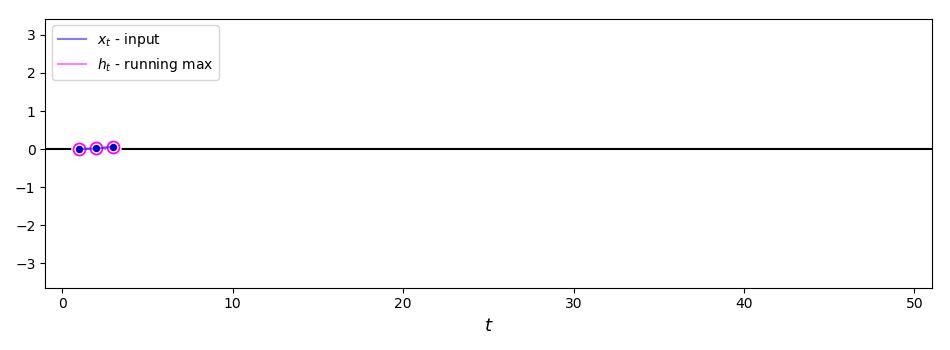
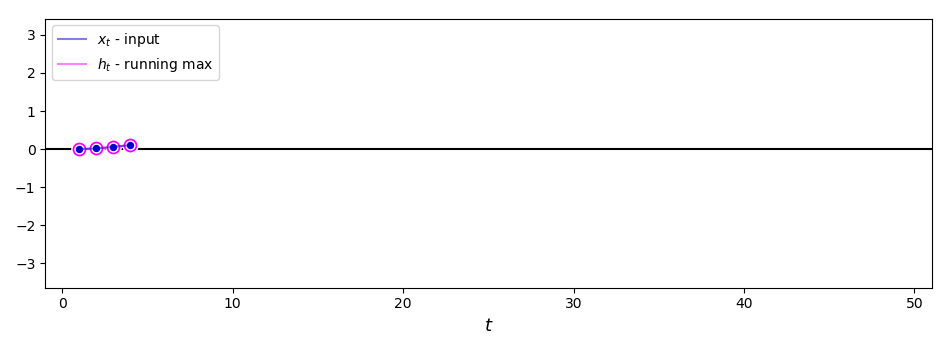
...
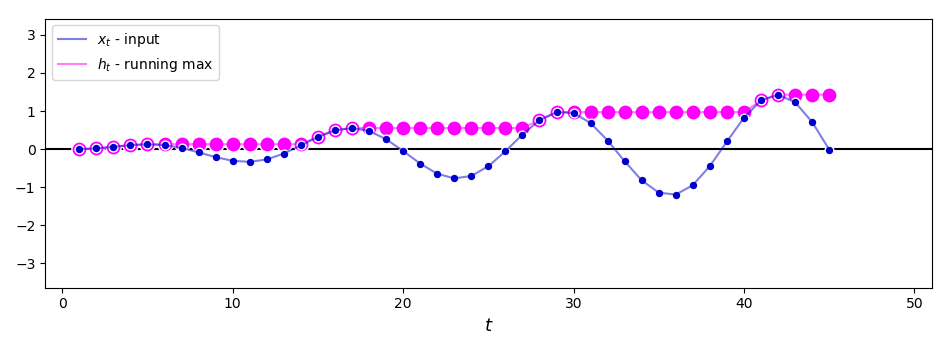
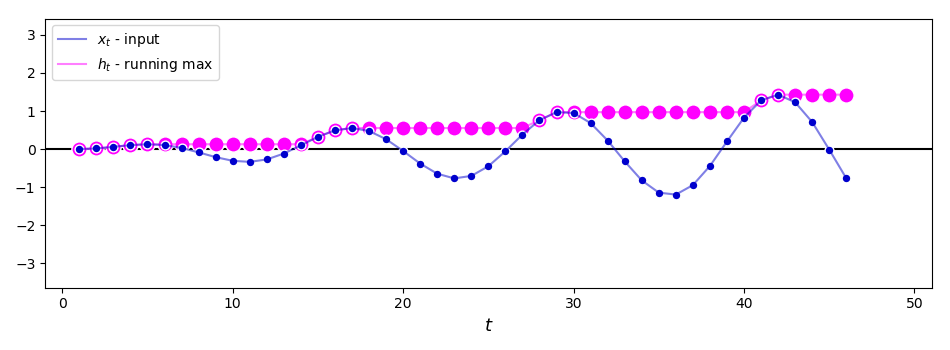
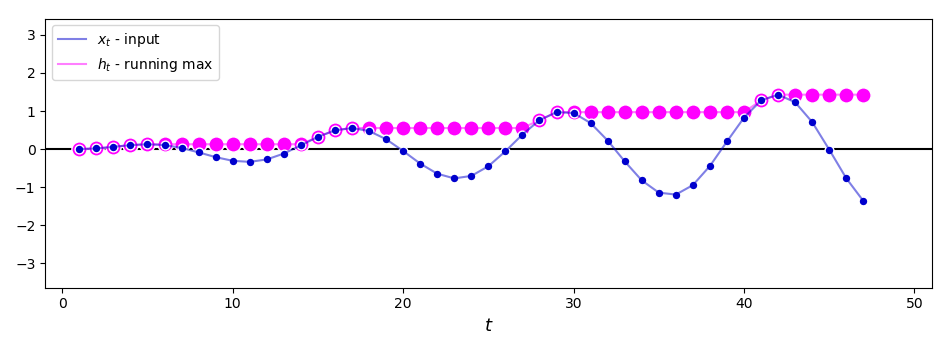
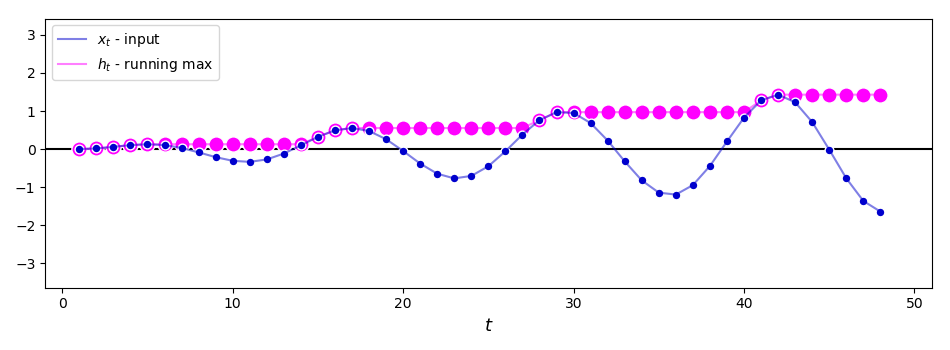
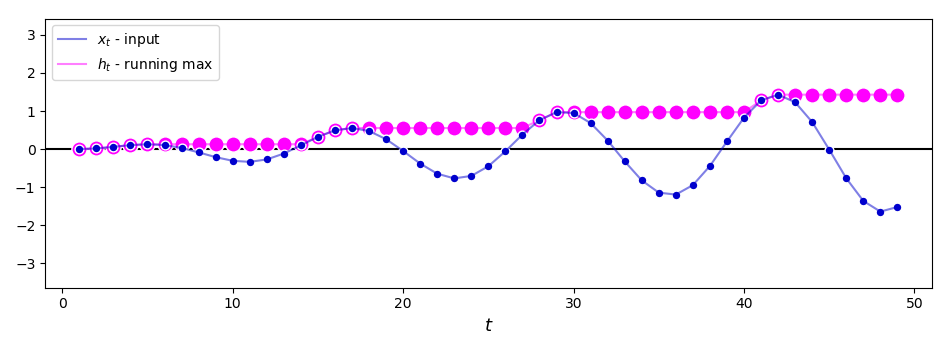

In [26]:
## This code cell will not be shown in the HTML version of this notebook
# an example input sequence of ordered data 
x = []
for t in range(50):
    x_t = 0.035*t*np.sin(0.5*t)
    x.append(x_t)  

# maximum
h = [x[0]]
for p in range(1,len(x)):
    # get current average and point
    ave = h[-1]
    x_p = x[p]

    # make next element
    new_ave = np.maximum(ave,x_p)
    h.append(new_ave)
    
plotter = anim.plot_input_with_hidden_together.Plotter(hidden_name = 'running max')
animator = anim.history_animators.Animator()
animator.animate_plot(plotter,x,h,num_frames = 100)

#### <span style="color:#a50e3e;">Example 5. </span> Count zero-crossings

- count the number of times a signal crosses the zero axis on the run

- can be written effeciently as a dynamic system with hidden state: $h_t = f\left(h_{t-1},x_t\right)$


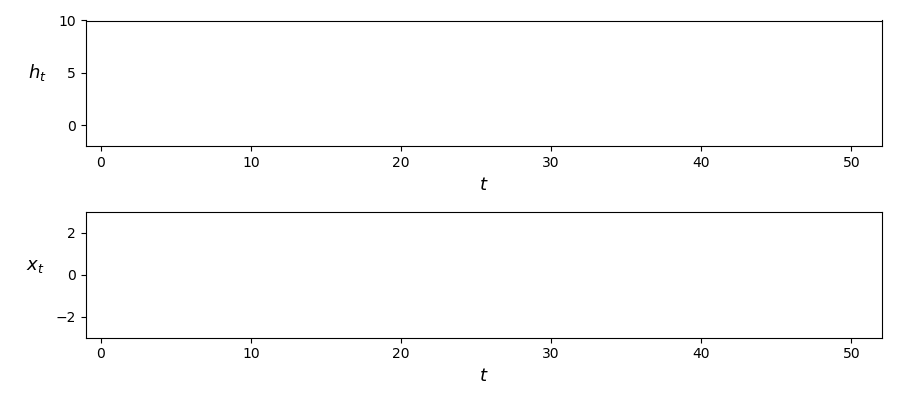
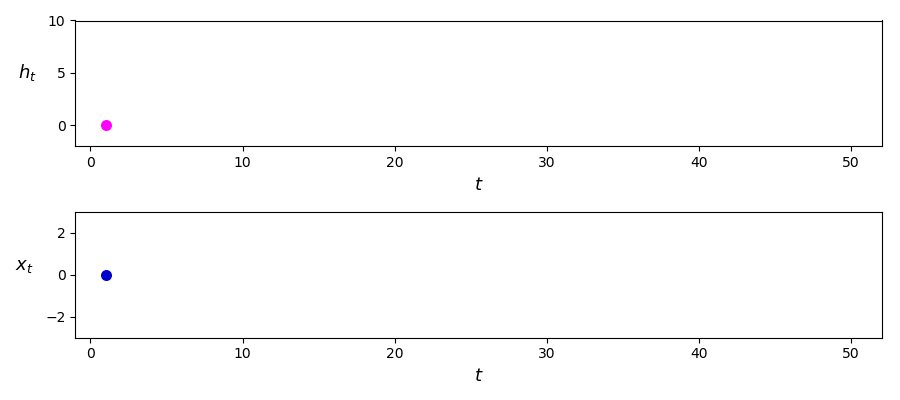
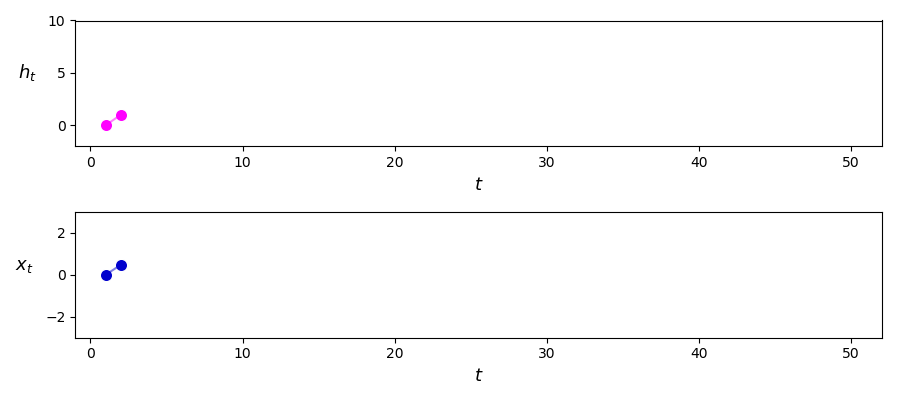
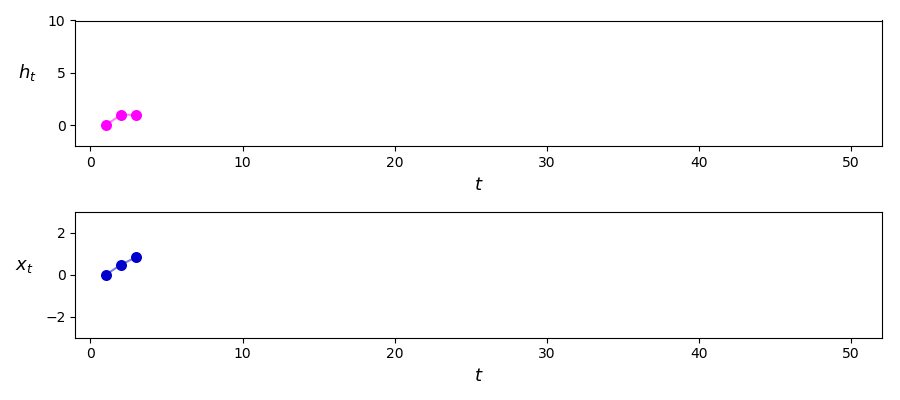
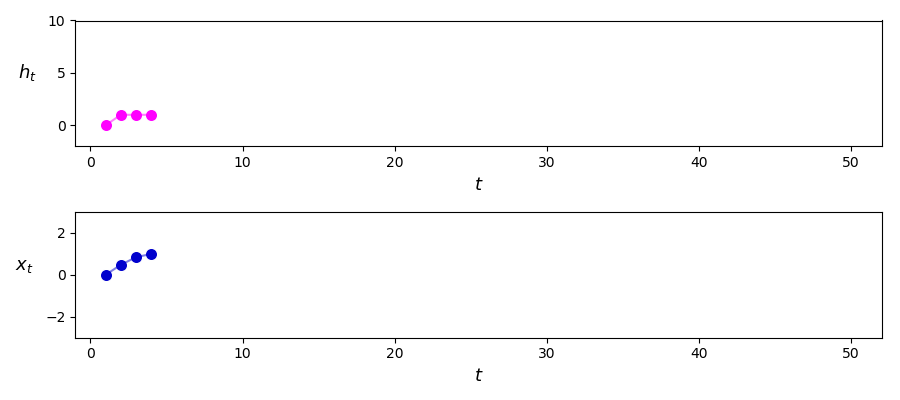
...
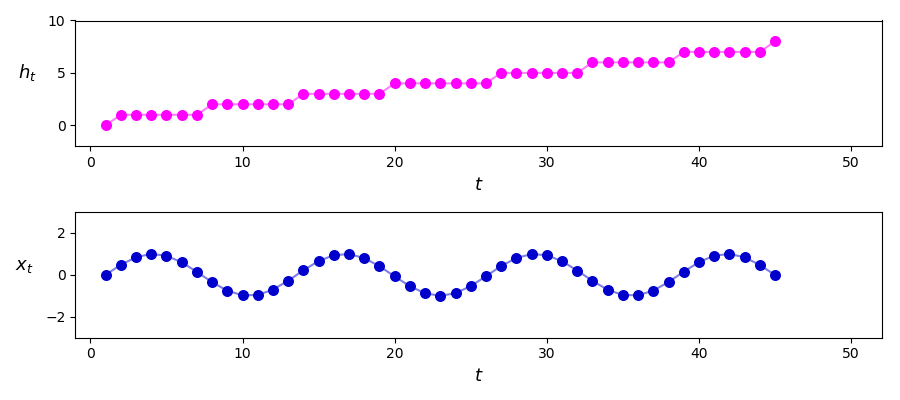
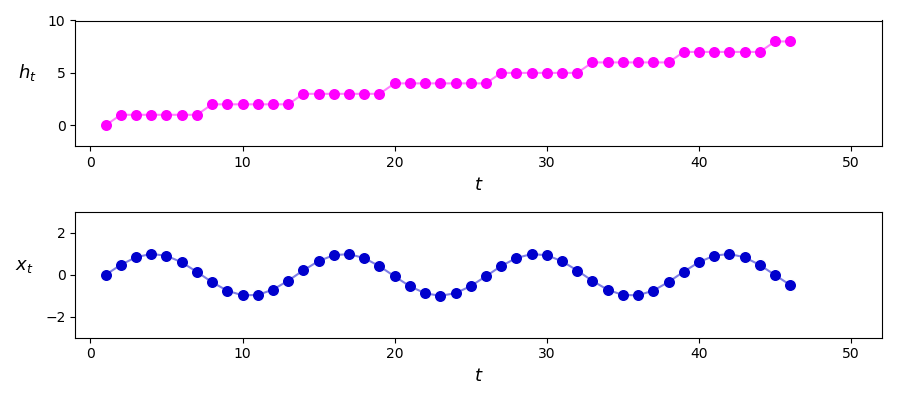
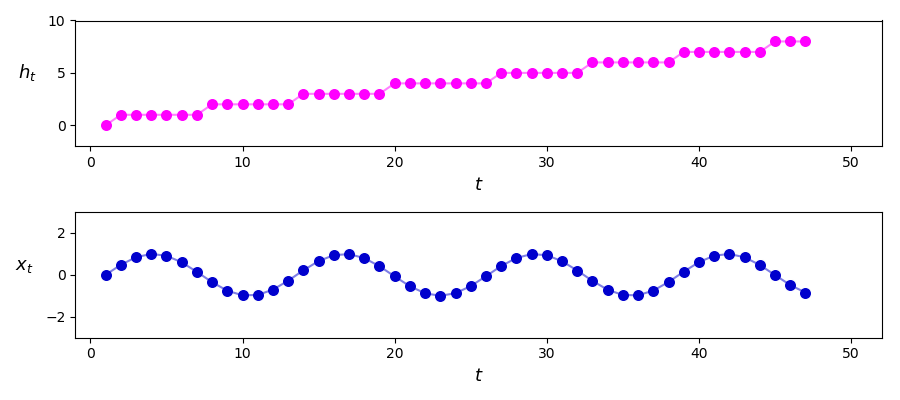
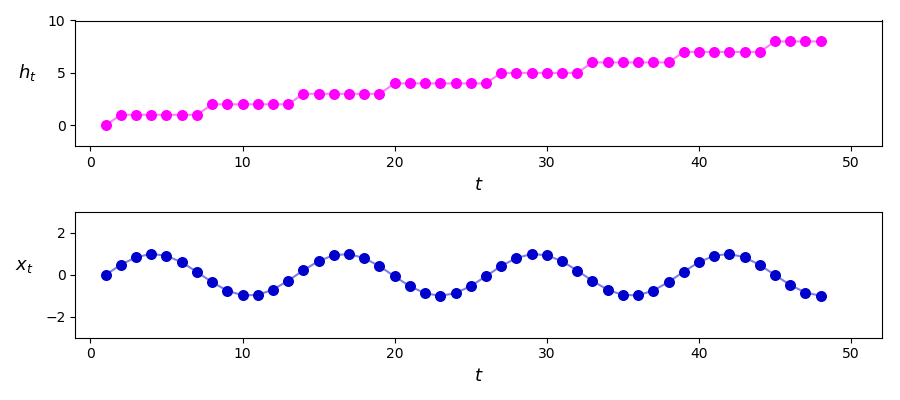
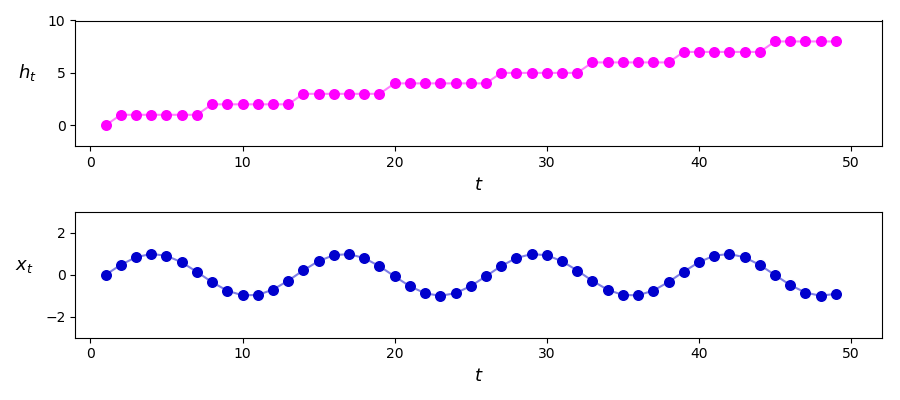

In [29]:
## This code cell will not be shown in the HTML version of this notebook
# an example input sequence of ordered data 
x = []
for t in range(50):
    x_t = np.sin(0.5*t)
    x.append(x_t)  

# running sum
def zero_cross_counter(x_t,x_t_minus_1):
    # determine if zero crossing has occured
    cross = 0
    if (x_t_minus_1 >=0 and x_t <= 0) or (x_t_minus_1 <=0 and x_t >= 0):
        cross = 1
    return cross

# create simulated monthly income
h = [x[0]]
for t in range(1,len(x)):
    # get current average and point
    h_t = h[-1]
    x_t_minus_1 = x[t-1]
    x_t = x[t]
    
    # make next element
    cross = zero_cross_counter(x_t,x_t_minus_1)
    h.append(h_t + cross)
    
plotter = anim.plot_input_with_hidden_separate.Plotter()
animator = anim.history_animators.Animator()
animator.animate_plot(plotter,x,h,num_frames = 100)

#### <span style="color:#a50e3e;">Example 6. </span>  Distribution

- heck, if you're willing to discretize you can design $h$ to accumulate an approximate distribution of past values 


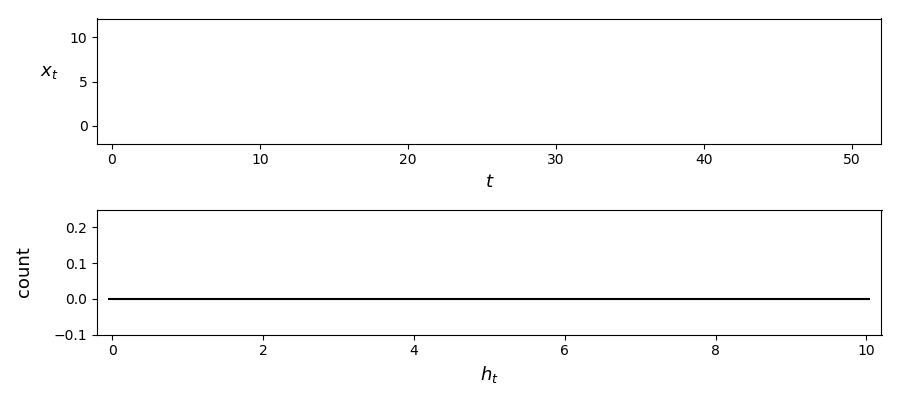
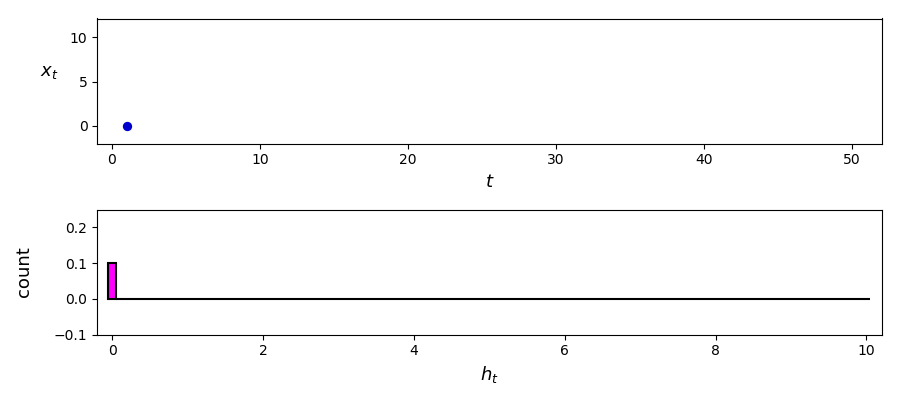
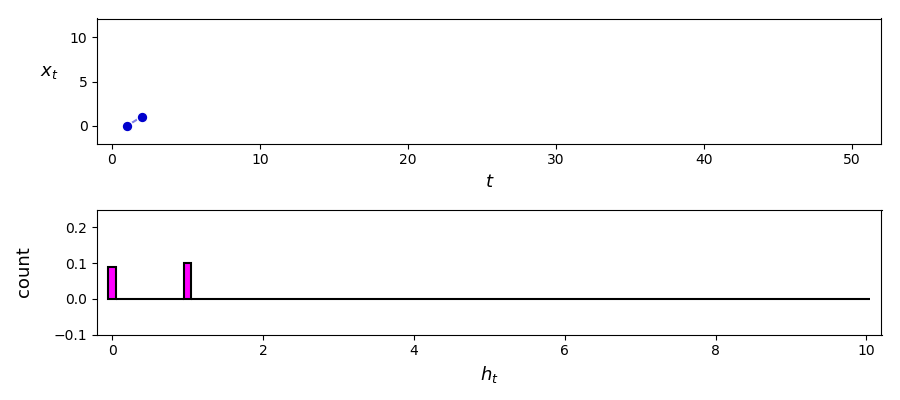
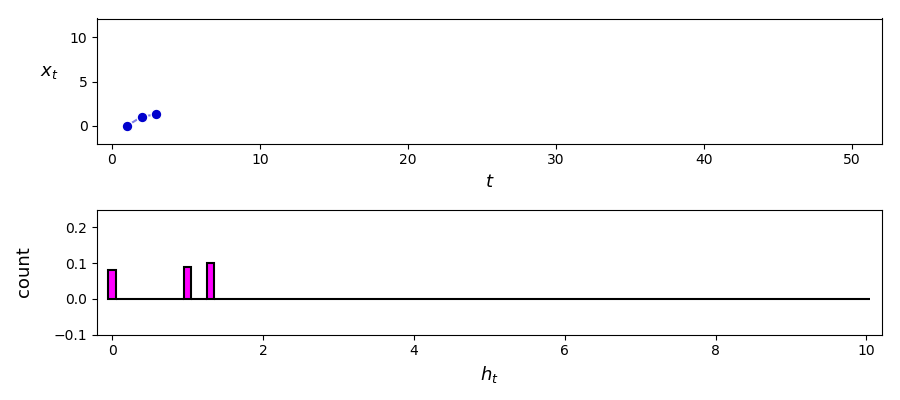
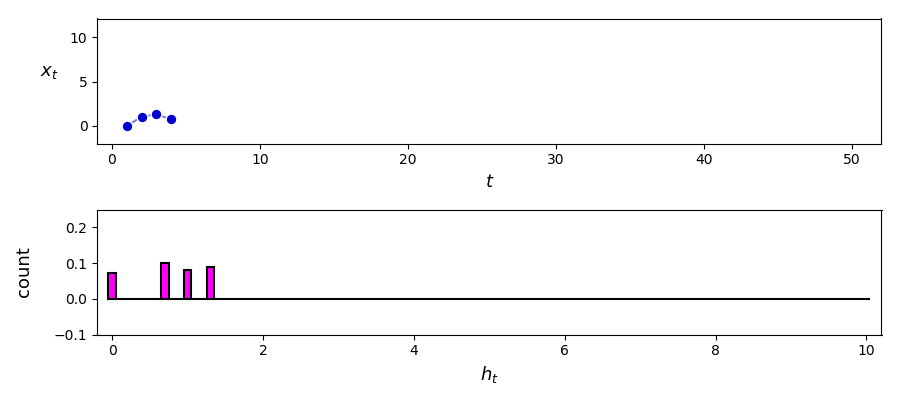
...
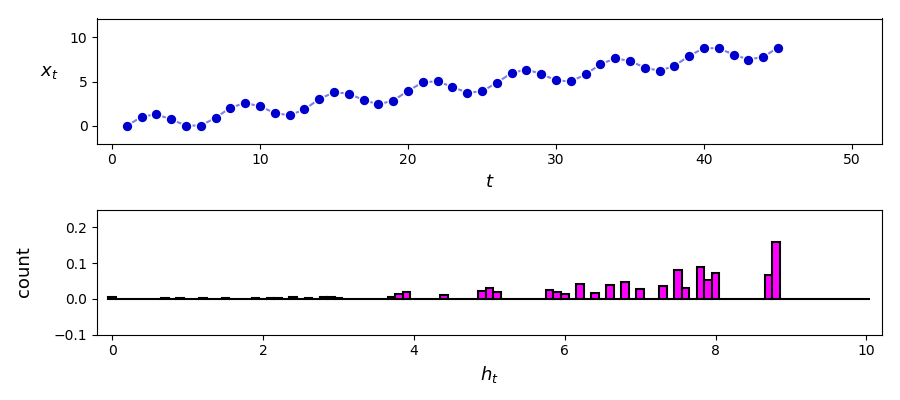
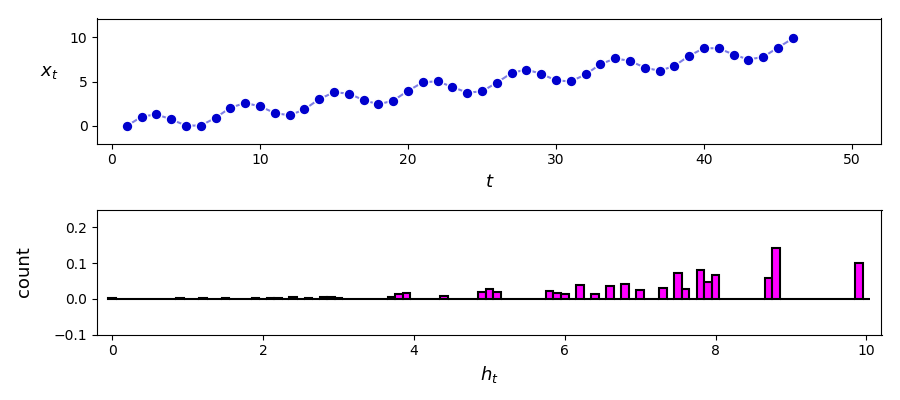
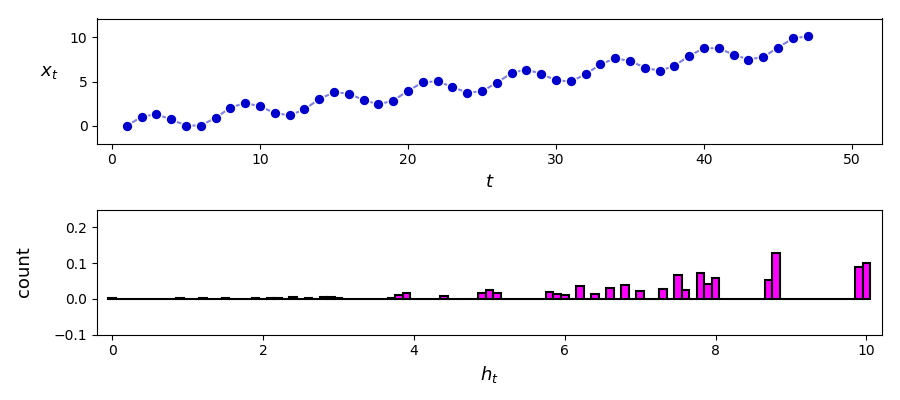
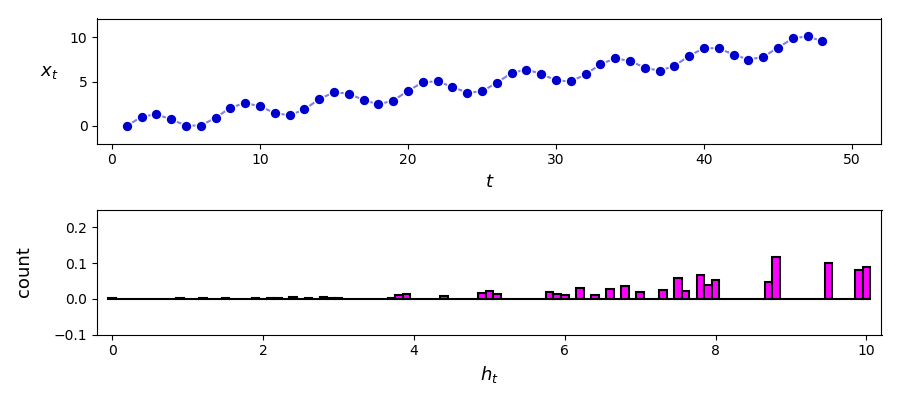
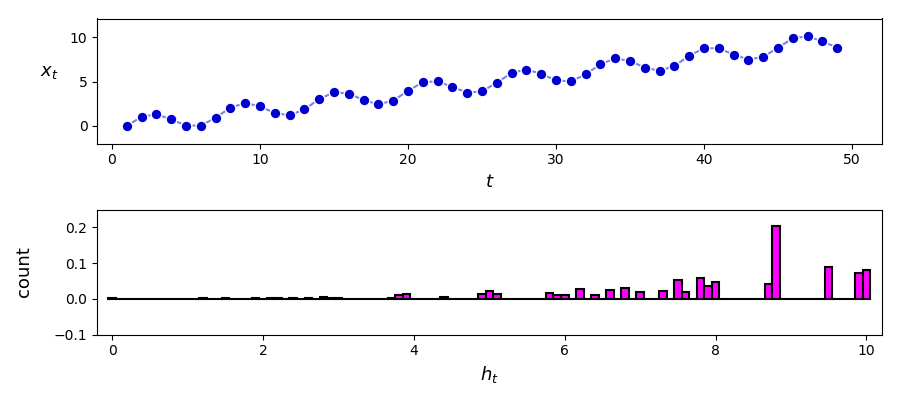

In [12]:
## This code cell will not be shown in the HTML version of this notebook

from collections import Counter

import numpy as np

# an example input sequence of ordered data 
x = []
for t in range(50):
    x_t = np.sin(t) + t*0.2
    x.append(x_t)  
    
# histogram history
def update_histogram(h_t,x_t,alpha):
    # update h
    for key in h_t.keys():
        h_t[key]=h_t[key]*(1 - alpha)
    
    # round to 100th decimal
    x_t = np.round(x_t,1)
    
    # ceiling / floor
    if x_t < 0:
        x_t = 0
    if x_t > 10:
        x_t = 10
    
    # one-hot encode
    h_t[x_t] += alpha

    return h_t

# initialize hidden (histogram) state
bins = np.unique(np.array([np.round(a,1) for a in np.linspace(0,10,10000)]))
h_t = {a:0 for a in bins}

# update hidden state
import copy
h_all = [copy.deepcopy(h_t)]
n = 1
for x_t in x:
    alpha = 0.1
    h_t = update_histogram(h_t,x_t,alpha)
    h_all.append(copy.deepcopy(h_t))
    n+=1

animator = anim.history_animators.Animator()
plotter = anim.plot_hidden_histogram.Plotter()
animator.animate_plot(plotter,x,h_all,num_frames = 100)

## You get the point, enough examples


- a simple *dynamic system with hidden states*, defined on an input sequence $x_1,\,x_2,...,x_t$, looks like

$$
h_t = f\left(h_{t-1},x_t\right)
$$

- $h_t$ *summarizes* the entire input $x_1,\,x_2,\,...,x_t$ depending on how $f$ is defined
    - e.g., as a raw sum, mean, exponential average, maximum, count of zero-crossings,...

- this is what people mean when they say an RNN / dynamic system has "infinite memory"

# 3.  Putting Humpty-Dumpty back together again

- remember, with supervised learning...

# Its all about models and param tuning


- to grasp standard *linear* supervised learning you need to *first* understand what a line / hyperplane since it is *the model* 


    - once you know what a line / hyperplane is, you can press it onto data 

- to grasp standard *nonlinear* supervised learning you *first* need to understand [nonlinear shapes]((https://jermwatt.github.io/mlrefined/blog_posts/11_Feature_learning/11_1_Universal.html)) 


    - once you know about trees, FNNs, etc., you can press them onto data (by tuning params)

- by analogy, to grasp RNNs you need to *first* understand "dynamic systems with hidden states"


    - once you know about them, you can press them onto data (by tuning params)

- well, you now know what a "dynamic system with hidden states" is - so you're ready to roll

- by using such a model, that has accumulator / summarizing states, you hope you can learn "long term dependencies" if they exist

# Using dynamic systems for supervised learning

- a general "vanilla" parameterized dynamic system with hidden states used for RNN-based supervised learning:
    
$$
 h_t = f\left(h_{t-1},x_t\right) = f\left(w_0 + h_{t-1}w_h + x_tw_x\right)
$$

where $f$ is a simple function (e.g., $\text{tanh}$, $\text{relu}$, etc., and $w_0,\,w_h,\,w_x$ are tunable parameters

- that is, to simplify things a linear combination of inputs is passed through a nonlinearity $f\left(\cdot\right)$

- for vector-valued input the analogous formula is used

$$
\mathbf{h}_t = f\left(\mathbf{w}_0 + \mathbf{W}_h\mathbf{h}_{t-1} + \mathbf{W}_x\mathbf{x}_t\right)
$$

#### <span style="color:#a50e3e;">Example 6. </span>  Time series analysis

- a vanilla application with a vanilla model...

<figure>
<p>
<img src= '../images/rnn_time_series.png' width="70%" height="50%" alt=""/>
</p>
<figcaption> <strong></strong> <center> <em>  Time series in black, training fit in blue, predictions in green.
    </em> </center>
</figcaption>
</figure>

#### <span style="color:#a50e3e;">Example 7. </span>  Generating text


- you've probably seen (twitter) bots that can spit out text that sounds like certain famous people (e.g., Shakespear, politicians, etc.,)

- one way to do this is by training a simple RNN model over a large training "corpus" of statements / writings of a particular person

- the text of this corpus is "one-hot-encoded" into standard basis vectors as so...

<figure>
<p>
<img src= '../images/one_hot_encoding.png' width="70%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em> 
</figcaption>
</figure>

- and then a model is trained on top, and learns to "mimic" their manner of writing / speaking

- for example, an H.G. Wells bot would be trained on his written books

- a small part of one-hot-encoded corpus would look like this

<figure>
<p>
<img src= '../images/text_gen_1.png' width="90%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em> 
</figcaption>
</figure>

- notice: the hidden state here summarizes a *distribution of prior characters* (since everything is one-hot-encoded), akin to Example 5

- a exponential average moving forward through the document leaves distributional heat traces that look like this

<figure>
<p>
<img src= '../images/text_gen_2.png' width="90%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em> 
</figcaption>
</figure>

- and such a trained RNN model produces results like these...

<figure>
<p>
<img src= '../images/text_gen_3.png' width="120%" height="24%" alt=""/>
</p>
<figcaption> <strong></strong> <em>  
</em> 
</figcaption>
</figure>

# 4. Epilogue

- a number of other topics to explore
    - **Optimization:** Swift to evaluate, slow to train, many tricks
    - **Modeling:** Very flexible modeling wise - can be used to model a wide array of weird things
    - **Deeper networks:** RNNs with many layers of hidden states (we discussed "shallow" RNNs today)